# Energy spectra in 2D

In [1]:
import os
import sys
import gc
import math as m
import numpy as np
import scipy
import pandas as pd
import pylab
from scipy import *
from scipy.signal import butter, filtfilt, hilbert
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from matplotlib import pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)
sys.path.append('/projects/DEIKE/cmartinb/jupyter_notebook/project_specific/turbulence')
sys.path.append('/projects/DEIKE/cmartinb/functions')
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from mpl_toolkits.axes_grid1 import make_axes_locatable
from prepare import load_object, save_object, field
from defs import Case, Interface2D
from phase import extract_phase
from funciones import * 
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pylab
import numpy as np
from scipy.signal import find_peaks
from scipy import stats
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable


import matplotlib.tri as mtri
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import scipy.interpolate
os.chdir('/projects/DEIKE/cmartinb/')

In [2]:
params = {'legend.fontsize': 'x-Large',
          'figure.figsize': (15, 6),
         'axes.labelsize': 30,
         'axes.titlesize':30,
         'xtick.labelsize':30,
         'ytick.labelsize':30,
    'font.family': 'STIXGeneral', 
    'axes.titleweight': 'normal',
    'axes.labelweight': 'normal',
    'text.usetex': True, # Enable LaTeX rendering
}

plt.rcParams.update(params)
pylab.rcParams.update(params)


In [3]:
# DEFINE CASE SO WE CAN AUTHOMATIZE IT 
kpHs = '0p16' # 0p16 
uoc = '0p50' # 0p50 0p75
reW = '2.5e4' #1.0e5
reA = 720
maxLevel = 10
Bo=200

if reW == '1.0e5':
    Re_water = 1 * 10**5
else:
    Re_water = 2.5 * 10**4

if uoc == '0p75':
    N = 1024
else:
    N = 512 

#Common parameters 
kp = 4
u = 0.5
lambdap = 2*m.pi/kp

L0 = 2*np.pi;


ak, c, omegap, nu_water, g , uoc_val= calculate_parameters(kpHs, uoc , u ,kp)
print('ak is', ak, 'c is' ,c, 'w_p$ is', omegap, '$\nu_w$ is' , nu_water, 'g is' ,g, 'N', N)

ak is 0.08 c is 1.0 w_p$ is 2.0 $
u_w$ is 6.283185307179586e-05 g is 1 N 512


In [4]:
work_dir = f'/projects/DEIKE/nscapin/broadband_reorder/re{reA}_bo0{Bo}_P{kpHs}_uoc{uoc}_reW{reW}_L{maxLevel}/'
data = np.loadtxt(work_dir+'eta/global_int.out')
#re720_bo0200_P0p16_uoc0p50_reW1.0e5_L10
istep_c =data[:, 1]
time = data[:,0] 
print(time.shape)

(721,)


In [5]:
#L0 = 2*np.pi; N = 512;
tstart = time[0]
#kp = 4; omegap = (1*kp)**0.5

In [6]:
eta_series = np.load(f'/projects/DEIKE/cmartinb/eta/eta_series_re{reA}_bo0{Bo}_P{kpHs}_uoc{uoc}_reW{reW}_L{maxLevel}.npy', allow_pickle=True)
print(eta_series.shape)

(721, 512, 512)


In [7]:
indice = np.argmax(omegap*(time - tstart) > 5)
print(indice)

eta_series_trimmed = eta_series[indice:, :]

print(eta_series_trimmed.shape)
time = time[indice:]

eta_series = eta_series_trimmed
print(time.shape)

26
(695, 512, 512)
(695,)


# $\eta(x,y)$

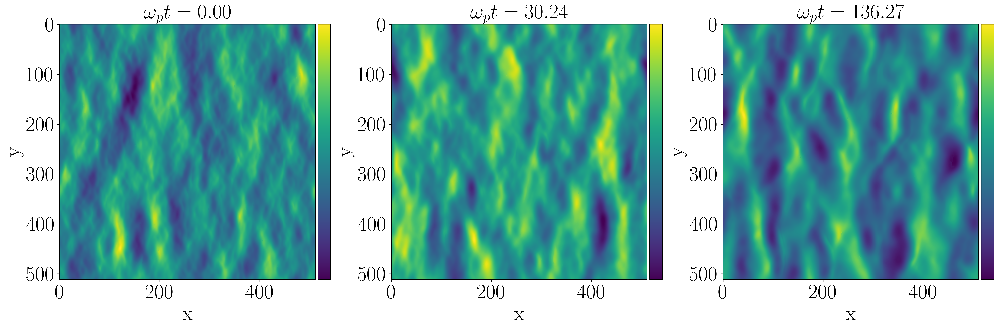

In [8]:
ind_time = [0,154,-1] #index of the times we are interested in (depends on length of time) 
num_rows = 1
num_cols = 3

kp = 4; omegap = (1*kp)**0.5

tstart=time[0]


fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 13))
j = 0

for i in ind_time:
    eta = eta_series[i]
    
    #vmin = 0
    #vmax = 5
    #levels = np.linspace(vmin, vmax, 1000)
    
    ax = axes[j % num_cols]
    im = ax.imshow(eta)  
    
    ax.set_aspect('equal')
    ax.set_title(label=r'$\omega_{p} t=%.2f$'%(omegap*(time[i]-tstart)))
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    cbar = fig.colorbar(im, cax=cax, orientation='vertical', extendrect = 'False')

    
    #cbar = fig.colorbar(im, ax=axs, pad=0.04, orientation='vertical',  extendrect = 'False', shrink= 0.6)
    cbar.ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'${int(x)}$'))
    cbar.ax.yaxis.set_major_locator(plt.FixedLocator([-20, -15, -10, -5, 0]))
    ax.figure.savefig(f'/projects/DEIKE/cmartinb/graphs/2D_spectra/kpHs{kpHs}uoc{uoc}/eta_{(omegap*(time[i]-tstart))}.png')
    
    j += 1
    
plt.tight_layout()
plt.show()

# $E(k_x, k_y)$

var 2.2959744e-05
mean 8.1874305e-08
sum F 2.2959742225602524e-05
integral 2.2959742225603835e-05
sum polar integrated 2.2909607736978235e-05
var 2.6726011e-05
mean -1.2115356e-07
sum F 2.672600961582131e-05
integral 2.6726009615822832e-05
sum polar integrated 2.660590654231783e-05
var 6.054976e-05
mean 7.68614e-08
sum F 6.054976140728285e-05
integral 6.05497614072863e-05
sum polar integrated 6.0230370863468886e-05


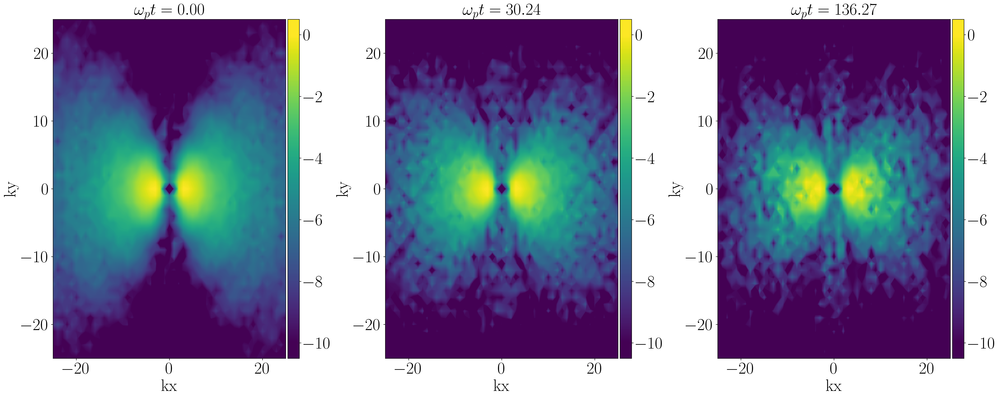

In [9]:
num_rows = 1
num_cols = 3

fig, axes = plt.subplots(num_rows, num_cols, figsize=(25, 10))
j = 0
lim = 200
L = 2*np.pi
for i in ind_time:
    
    eta = eta_series[i]
    
    k, F_center, F_center_polar_integrated, F_center_polar, k_tile, kxp_tile, kyp_tile, theta_tile, theta, variance, integral, polar_integral, kx, ky = spectrum_integration(eta - np.mean(eta), N, L, CHECK=True) #ypu can chose to check the normalization
    
    norm = np.argmax(F_center)
    
    vmin = -10
    vmax = 0
    levels = np.linspace(vmin, vmax, 200)
    
    ax = axes[j % num_cols]
    
    im = ax.contourf(kx, ky, np.log(F_center/np.max(F_center)), extend='both', levels=levels)
    
    #ax.set_aspect('equal')
    ax.set_title(label=r'$\omega_{p} t=%.2f$' % (omegap * (time[i] - tstart)))
    ax.set_xlabel('kx')
    ax.set_ylabel('ky')
    ax.set_ylim([-25, 25])
    ax.set_xlim([-25, 25])
    
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    cbar = fig.colorbar(im, cax=cax, orientation='vertical', extendrect = 'False')
    
    cbar.ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'${int(x)}$'))
    #cbar.ax.yaxis.set_major_locator(plt.FixedLocator([-20, -15, -10, -5, 0]))
    ax.figure.savefig(f'/projects/DEIKE/cmartinb/graphs/2D_spectra/kpHs{kpHs}uoc{uoc}/Ekxky_{(omegap*(time[i]-tstart))}.png')
    j += 1
    
plt.tight_layout()
plt.show()

# $E(k, \theta)$

var 2.2959744e-05
mean 8.1874305e-08
sum F 2.2959742225602524e-05
integral 2.2959742225603835e-05
sum polar integrated 2.2909607736978235e-05
var 2.6726011e-05
mean -1.2115356e-07
sum F 2.672600961582131e-05
integral 2.6726009615822832e-05
sum polar integrated 2.660590654231783e-05
var 6.054976e-05
mean 7.68614e-08
sum F 6.054976140728285e-05
integral 6.05497614072863e-05
sum polar integrated 6.0230370863468886e-05


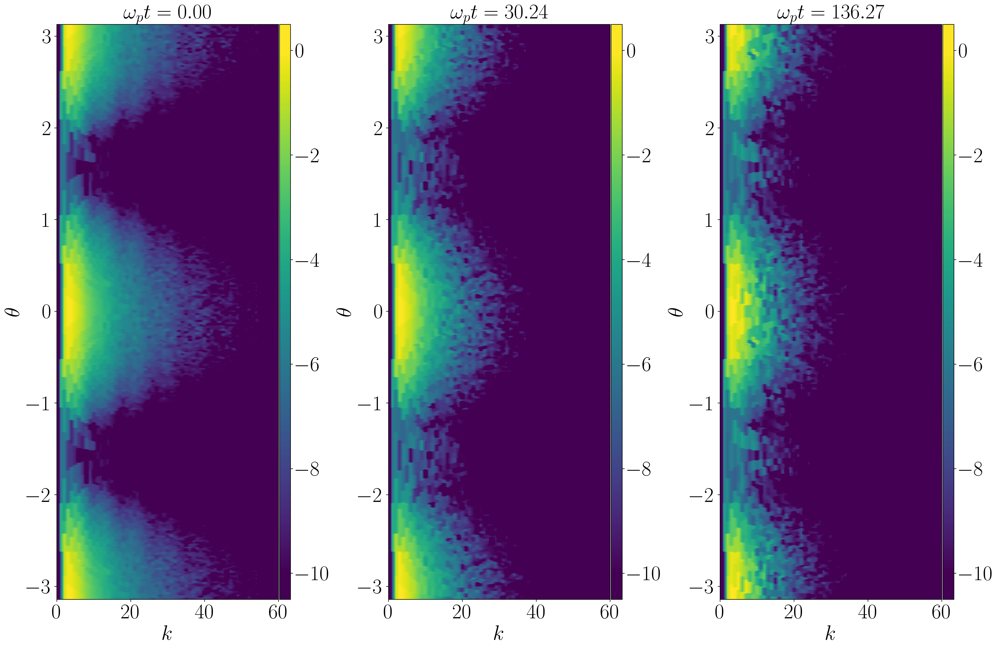

In [10]:
num_rows = 1
num_cols = 3

fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 13))
j = 0

variance =[]
integral = []
polar_integral = []

for i in ind_time:
    eta = eta_series[i]
    
    k, F_center, F_center_polar_integrated , F_center_polar , k_tile, kxp_tile, kyp_tile , theta_tile , theta , variance, integral, polar_integral , kx, ky = spectrum_integration(eta-np.mean(eta), N,L,CHECK=True)
    
    vmin = -10
    vmax= 0
    levels = np.linspace(vmin, vmax, 200)
    
    
    plt.contourf(k_tile,theta_tile,np.log(F_center_polar/np.max(F_center_polar)), levels=levels,  extend='both' )#, cmap='viridis')
    
    ax = axes[j % num_cols]

    im = ax.contourf(k_tile,theta_tile,np.log(F_center_polar/np.max(F_center_polar)), levels=levels ,  extend='both')#, cmap='viridis')
    
    #ax.scatter(4,0,marker ='*', s=1, alpha= 1, c='r' )
    
    ax.set_title(label=r'$\omega_{p} t=%.2f$'%(omegap*(time[i]-tstart)))
    
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.02)
    cbar = fig.colorbar(im, cax=cax, orientation='vertical', extendrect = 'False', fraction = 0.05, pad = 0.02,aspect =10)
    
    cbar.ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'${int(x)}$'))
    #cbar.ax.yaxis.set_major_locator(plt.FixedLocator([-20, -15, -10, -5, 0]))
    
    ax.set_xlim([0,60])
    ax.set_xlabel('$k$')
    ax.set_ylabel(r"$ \theta $")
    ax.figure.savefig(f'/projects/DEIKE/cmartinb/graphs/2D_spectra/kpHs{kpHs}uoc{uoc}/Ektheta_{(omegap*(time[i]-tstart))}.png')
    j += 1
    

plt.tight_layout()
#plt.savefig("g1_tend", dpi=300)
plt.show()

# $E(k,t)$

/tmp/ipykernel_1652366/11444846.py:105: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  plt.xlim([0,10])


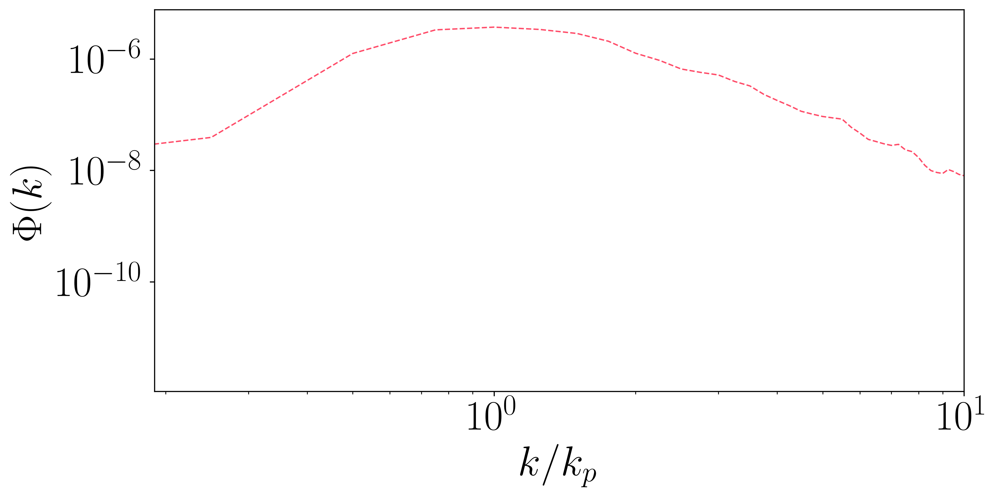

In [11]:
color_map = plt.cm.gist_rainbow
fig = plt.figure(figsize=(10, 5))
ax = fig.gca()

num_rows = 2
num_cols = 3

kp = 4
j = 0

variance = []
integral = []
polar_integral = []

# modes growth
energy_mode = []
coordx_mode = []
k_second = []

energy_secondmode = []
coordx_secondmode =[]
pylab.rcParams.update(params)

filtered_coordx_mode = []
filtered_energy_mode = []

#Loop in time


#for i in range(len(eta_series)):
for i in range(1):
    
    eta = eta_series[i]
    #print(i, variance)
    k, F_center, F_center_polar_integrated, F_center_polar, k_tile, kxp_tile, kyp_tile, theta_tile, theta, varr, integ, int_pol , kx, ky = spectrum_integration(
        eta - np.mean(eta), N, L, CHECK=False)
    #print('k', k, 'kx', kx[int(len(kx)/2):])
    #k = kx[int(len(kx)/2):]
    dk = k[1] - k[0]
    
    #print(k)
    if i == 0:

        indices1 = np.arange(0, np.where(k >= 1)[0][0], max(1, int(0.25 / dk)))
        indices10 = np.arange(np.where(k >= 1)[0][0], np.where(k >= 10)[0][0], max(1, int(1 / dk)))
        indices1020 = np.arange(np.where(k >= 10)[0][0], np.where(k > 40)[0][0], max(1, int(1 / dk)))
        indices100 = np.arange(np.where(k >= 20)[0][0], np.where(k > 100)[0][0], max(1, int(10/ dk)))
        indicesplus = np.arange(np.where(k >= 100)[0][0], len(k), max(1, int(20 / dk)))

        k_multiples = np.concatenate((indices1, indices10, indices1020 ,indices100, indicesplus))

        k_multiples = k_multiples.astype(int)
        # Obtener los valores de k y las energías correspondientes
        k_seleccionados = k[k_multiples]
        psd = ax.plot(k/4, F_center_polar_integrated, '--', color=plt.cm.get_cmap('gist_rainbow')(j), alpha=0.7, linewidth=1)
        
    energias_correspondientes = F_center_polar_integrated[k_multiples]
    #k = k/4
    
    if i == 0:
        E0_both = np.sum(F_center_polar_integrated) * dk
        #print(type(indices_cada_diez))
        E0_nodes_both = F_center_polar_integrated[k_multiples]
        #E0_second_both =  F_center_polar_integrated[k_second]
    
    #if i % 5 == 0:
        #psd = ax.plot(k/4, F_center_polar_integrated, '--', color=plt.cm.get_cmap('gist_rainbow')(j), alpha=0.7, linewidth=1)
    
    energy_mode.append(energias_correspondientes.tolist())
    #coordx_mode.append(coordx.tolist())
    integral.append(integ)
    variance.append(varr)
    polar_integral.append(int_pol)
    
 
    j += 1

# plot where are the nodes

#for km in k_seleccionados:
    #plt.axvline(x=km, color='gray', linestyle='--', linewidth=0.3)
    
#ax.ticklabel_format(style='sci', axis='y', scilimits=(0, 0))
#plt.legend(loc='upper right', fontsize=4)


color_values =  (omegap*(np.array(time)-time[0]))

# Now set the normalization with the correct range

norm = plt.Normalize(vmin=color_values.min(), vmax=color_values.max())
sm = plt.cm.ScalarMappable(cmap=color_map, norm=norm)
sm.set_array([])  

# Add the colorbar to the figure
#cbar = plt.colorbar(sm, orientation='horizontal', pad=0.2)

# Set colorbar label and other properties if needed
#cbar.set_label('$\omega_{p} t$')


fig.tight_layout()
#cbar.set_label('$\omega_{p} t$')
plt.xscale('log')
plt.xlim([0,10])
#plt.ylim([10**-11,10**-3])
plt.yscale('log')
plt.xlabel('$\mathdefault{k/k_{p}}$')
plt.ylabel('$\mathdefault{\Phi(k)}$')
plt.savefig(f'/projects/DEIKE/cmartinb/graphs/2D_spectra/kpHs{kpHs}uoc{uoc}/Ek_total.png')
fig.tight_layout()

/tmp/ipykernel_1652366/2964781618.py:115: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  plt.xlim([0,10])


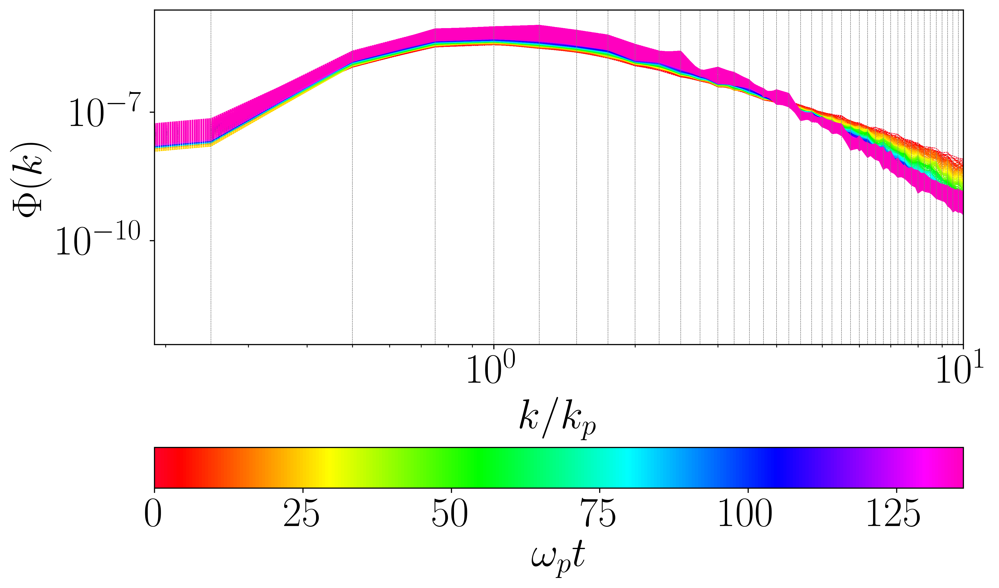

In [12]:
import matplotlib.cm as cm
from scipy.interpolate import interp1d
from scipy import integrate
import csv

fig = plt.figure(figsize=(10, 6))
color_map = plt.cm.gist_rainbow
ax = fig.gca()

num_rows = 2
num_cols = 3

j = 0

variance = []
integral = []
polar_integral = []

k_seleccionados =[]

# modes growth
energy_interval_time = []
coordx_mode = []
k_second = []

energy_secondmode = []
coordx_secondmode =[]

F_mode =[]
filtered_coordx_mode = []
filtered_energy_mode = []

E_interval = []

with open(f'/projects/DEIKE/cmartinb/eta/eta_series_re{reA}_bo0{Bo}_P{kpHs}_uoc{uoc}_reW{reW}_L{maxLevel}_energies.csv', 'w', newline='') as file:
    writer = csv.writer(file)
    for i in range(len(eta_series)):

        #recorre el tiempo

        eta = eta_series[i]

        k, F_center, F_center_polar_integrated, F_center_polar, k_tile, kxp_tile, kyp_tile, theta_tile, theta, varr, integ, int_pol , kx, ky = spectrum_integration(
            eta - np.mean(eta), N, L, CHECK=False)

        E_interval = []

        #print(i)

        for m in range(41):
            if m == 0:
                # Primer punto
                idx_start, idx_end = 0, 1
            elif m == len(k) - 1:
                # Último punto
                idx_start, idx_end = m - 1, m
            else:
                # Puntos intermedios
                idx_start, idx_end = m - 1, m + 1
                
            F_integral_interval = integrate.trapezoid(F_center_polar_integrated[idx_start:idx_end+1], k[idx_start:idx_end+1])
            
            #print('idx start',idx_start, 'idx end', idx_end )
            
            k_seleccionados.append(k[m]) # lista con la energia de cada intervalo [IN .....IN]

            psd = ax.plot(k/4, F_center_polar_integrated, '--', color=plt.cm.get_cmap('gist_rainbow')(j), alpha=0.7, linewidth=0.3)

            #ax.axvline(x = k[m]/4, color = 'grey', alpha =0.3)
            
            #print('k[idx_start]',k[idx_start],'k[idx_end]', k[idx_end])
            
            #print('i',i,'interval' ,k[idx_start:idx_end+1], 'F_center_polar_integrated',F_center_polar_integrated[idx_start:idx_end+1], 'F ingrated interpol', F_integral_interval,'l',m)

            E_interval.append(F_integral_interval)
            
            writer.writerow([i, m, F_integral_interval, omegap*(time[i]-time[0])])
            
            #f.write(interval_str)
        
        energy_interval_time.append(E_interval) #lista con la energia de todos intervalos para cada tiempo [[I1.... IN]_0.....[IN...IN]_N] en tiempo i

        #writer.writerow(E_interval)
        
        
        j += 1

# plot where are the nodes

for km in k_seleccionados:
    ax.axvline(x=km/4, color='gray', linestyle='--', linewidth=0.3)

ax.ticklabel_format(style='sci', axis='y', scilimits=(0, 0))
#plt.legend(loc='upper right', fontsize=4)


color_values =  (omegap*(np.array(time)-time[0]))

# Now set the normalization with the correct range

norm = plt.Normalize(vmin=color_values.min(), vmax=color_values.max())
sm = plt.cm.ScalarMappable(cmap=color_map, norm=norm)
sm.set_array([])  

# Add the colorbar to the figure
cbar = plt.colorbar(sm, orientation='horizontal', pad=0.2)

# Set colorbar label and other properties if needed
cbar.set_label('$\omega_{p} t$')


fig.tight_layout()
cbar.set_label('$\omega_{p} t$')
plt.xscale('log')
plt.xlim([0,10])
#plt.ylim([10**-8,1])
plt.yscale('log')
plt.xlabel('$\mathdefault{k/k_{p}}$')
plt.ylabel('$\mathdefault{\Phi(k)}$')
plt.savefig(f'/projects/DEIKE/cmartinb/graphs/2D_spectra/kpHs{kpHs}uoc{uoc}/Ek_total.png')
fig.tight_layout()

In [13]:
df = pd.read_csv(f'/projects/DEIKE/cmartinb/eta/eta_series_re{reA}_bo0{Bo}_P{kpHs}_uoc{uoc}_reW{reW}_L{maxLevel}_energies.csv', names=['i', 'k', 'F_integral_interval', 'time'])

In [14]:
# Crear una columna de grupo para cada 'i' que indique el número de intervalo
df['interval_num'] = df.groupby('i').cumcount()

# Ahora pivotar el DataFrame para que cada fila sea una 'i' y cada columna un intervalo
df_pivot = df.pivot(index='i', columns='interval_num', values='F_integral_interval')

# Si deseas que el DataFrame resultante tenga únicamente los valores de integración sin los índices de intervalos como nombres de columnas
df_pivot.columns = [f'interval_{i}' for i in range(len(df_pivot.columns))]

# Resetea el índice para que 'i' sea una columna normal en lugar de un índice
df_pivot = df_pivot.reset_index()

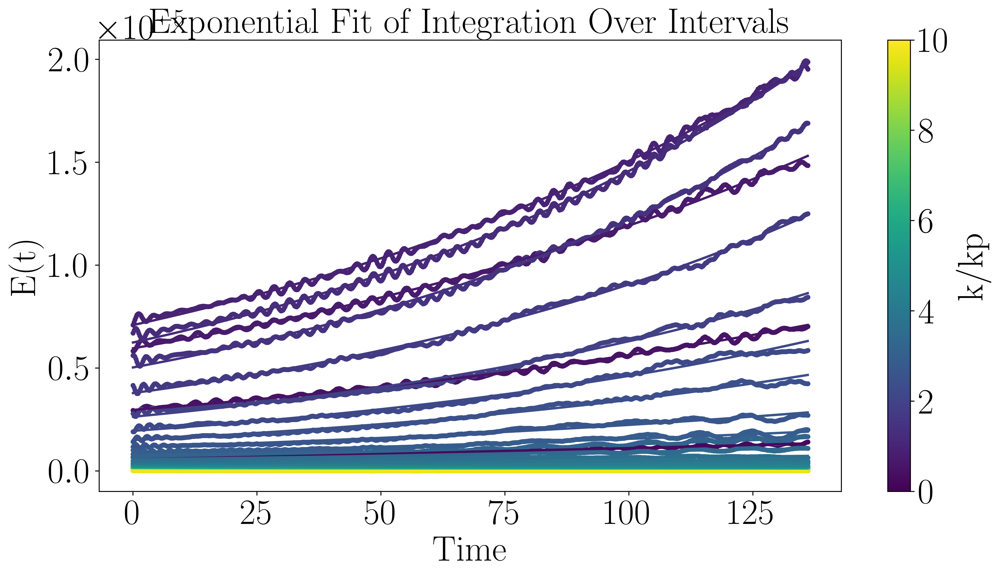

Growth betas: [0.003924620536670655, 0.005254921707784182, 0.006416532579609615, 0.006936445430826322, 0.007539993897407004, 0.008483272027720137, 0.008885753862173782, 0.008742569346989746, 0.008737795194196154, 0.008650957374184134, 0.008349882921822602, 0.006647931182761571, 0.005621335552100376, 0.006262623962037237, 0.004855800308169203, 0.003416055157046134, 0.003298873208779695, 0.002687461030568915]
Decay betas: [-0.00024827669799969967, -0.0022843480755470606, -0.002549423391343687, -0.0023781466363981575, -0.0034458109838327515, -0.0070005800889531115, -0.00939379706383962, -0.009395843113212864, -0.009844309226069306, -0.012614127813848575, -0.01573080012449308, -0.017770644103096686, -0.01933759275228961, -0.022335083609057914, -0.02850880586442695, -0.030559900750142262, -0.031618736006411984, -0.03652336925337239, -0.045227330055517254, -0.05327577994258335, -0.058986628930749116, -0.06531227074462037, -0.07121635319900514]
Growth k: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,

In [15]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from scipy.optimize import curve_fit

# Asumiendo que 'df_pivot' es tu DataFrame y que 'time' y 'k_seleccionados' están definidos
colormap = cm.viridis
normalize = plt.Normalize(vmin=0, vmax=(len(df_pivot.columns) - 2)/4)  # normalizar basado en el número de intervalos

# Crear una figura y un eje para el ploteo
fig, ax = plt.subplots(figsize=(14, 7))

# Definir la función del modelo exponencial
def exp_model(x, a, b):
    return a * np.exp(b * x)

# Crear listas para almacenar los parámetros de crecimiento y decadencia
beta_growth = []
beta_decay = []

k_growth = []
k_decay = []

# Iterar sobre cada intervalo y realizar ajuste exponencial
for idx, column in enumerate(df_pivot.columns[1:]):  # Ignora la primera columna que es 'i'
    # Extraer datos para el intervalo actual
    mode_total_norm = df_pivot[column].dropna()  # Eliminar valores NaN por seguridad
    tiempo_valido = omegap*(time[:len(mode_total_norm)-1]-tstart)  # Asegurar que tiempo y mode_total_norm tengan la misma longitud
    
    mode_total_norm = mode_total_norm[:-1]
    
    # Ajuste exponencial solo si todos los valores son positivos y hay suficientes datos
    if len(mode_total_norm) > 1 and np.all(mode_total_norm > 0):
        popt, pcov = curve_fit(exp_model, tiempo_valido, mode_total_norm, p0=(1, 0.001), maxfev=100000)
        a, b = popt
        if b > 0:
            beta_growth.append(b)
            k_growth.append(idx)
        else:
            beta_decay.append(b)
            k_decay.append(idx)
        
        # Realizar gráfico para cada intervalo
        color = cm.viridis(idx / len(df_pivot.columns[1:]))  # Normalizar color
        ax.scatter(tiempo_valido, mode_total_norm, color=color, s=10)
        ax.plot(tiempo_valido, exp_model(tiempo_valido, *popt), color=color, lw=2)

# Configurar gráfico
ax.set_xlabel('Time')
ax.set_ylabel('E(t)')
ax.set_title('Exponential Fit of Integration Over Intervals')
plt.colorbar(cm.ScalarMappable(norm=normalize, cmap=colormap), label='k/kp')
#plt.legend()
plt.savefig(f'/projects/DEIKE/cmartinb/graphs/2D_spectra/kpHs{kpHs}uoc{uoc}/Exp_fit.png')
plt.show()

# Imprimir los valores de beta para crecimiento y decadencia
print("Growth betas:", beta_growth)
print("Decay betas:", beta_decay)
print("Growth k:", k_growth)
print("Growth k:", k_decay)

In [16]:
'''
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from scipy.optimize import curve_fit

# Definir la función del modelo exponencial
def exp_model(x, a, b):
    return a * np.exp(b * x)

# Asumiendo que 'df_pivot' es tu DataFrame y que 'time' y 'k_seleccionados' están definidos
colormap = cm.viridis
normalize = plt.Normalize(vmin=0, vmax=(len(df_pivot.columns) - 2)/4)  # normalizar basado en el número de intervalos

# Crear una figura y un eje para el ploteo
fig, ax = plt.subplots(figsize=(14, 7))

# Crear listas para almacenar los parámetros de crecimiento y decadencia
beta_growth = []
beta_decay = []

k_growth = []
k_decay = []

# Iterar sobre cada intervalo y realizar ajuste exponencial
for idx, column in enumerate(df_pivot.columns[1:]):  # Ignora la primera columna que es 'i'
    # Extraer datos para el intervalo actual
    mode_total_norm = df_pivot[column].dropna()  # Eliminar valores NaN por seguridad
    tiempo_valido = omegap * (time[:len(mode_total_norm)] - tstart)  # Asegurar que tiempo y mode_total_norm tengan la misma longitud
    
    # Ajuste exponencial solo si todos los valores son positivos y hay suficientes datos
    if len(mode_total_norm) > 1 and np.all(mode_total_norm > 0):
        popt, pcov = curve_fit(exp_model, tiempo_valido, mode_total_norm, p0=(1, 0.001), maxfev=10000)
        a, b = popt
        if b > 0:
            beta_growth.append(b)
            k_growth.append(idx)
        else:
            beta_decay.append(b)
            k_decay.append(idx)
        
        # Realizar gráfico para cada intervalo
        color = cm.viridis(idx / len(df_pivot.columns[1:]))  # Normalizar color
        ax.scatter(tiempo_valido, mode_total_norm, color=color, s=10)
        ax.plot(tiempo_valido, exp_model(tiempo_valido, *popt), color=color, lw=2)
        
        # Guardar cada gráfico individualmente
        plt.savefig(f'/projects/DEIKE/cmartinb/graphs/2D_spectra/kpHs{kpHs}uoc{uoc}/mode_kokp{idx/kp}.png')

# Configurar gráfico
ax.set_xlabel(r'$\omega_{p} t$')
ax.set_ylabel(r'$E_{k}(t)$')
ax.set_title('Evolution energy over time for each mode')
plt.colorbar(cm.ScalarMappable(norm=normalize, cmap=colormap), label='k/kp')
plt.yscale('log')

plt.show()

# Imprimir los valores de beta para crecimiento y decadencia
print("Growth betas:", beta_growth)
print("Decay betas:", beta_decay)
print("Growth k:", k_growth)
print("Decay k:", k_decay)
'''

'\nimport numpy as np\nimport matplotlib.pyplot as plt\nimport matplotlib.cm as cm\nfrom scipy.optimize import curve_fit\n\n# Definir la función del modelo exponencial\ndef exp_model(x, a, b):\n    return a * np.exp(b * x)\n\n# Asumiendo que \'df_pivot\' es tu DataFrame y que \'time\' y \'k_seleccionados\' están definidos\ncolormap = cm.viridis\nnormalize = plt.Normalize(vmin=0, vmax=(len(df_pivot.columns) - 2)/4)  # normalizar basado en el número de intervalos\n\n# Crear una figura y un eje para el ploteo\nfig, ax = plt.subplots(figsize=(14, 7))\n\n# Crear listas para almacenar los parámetros de crecimiento y decadencia\nbeta_growth = []\nbeta_decay = []\n\nk_growth = []\nk_decay = []\n\n# Iterar sobre cada intervalo y realizar ajuste exponencial\nfor idx, column in enumerate(df_pivot.columns[1:]):  # Ignora la primera columna que es \'i\'\n    # Extraer datos para el intervalo actual\n    mode_total_norm = df_pivot[column].dropna()  # Eliminar valores NaN por seguridad\n    tiempo_va

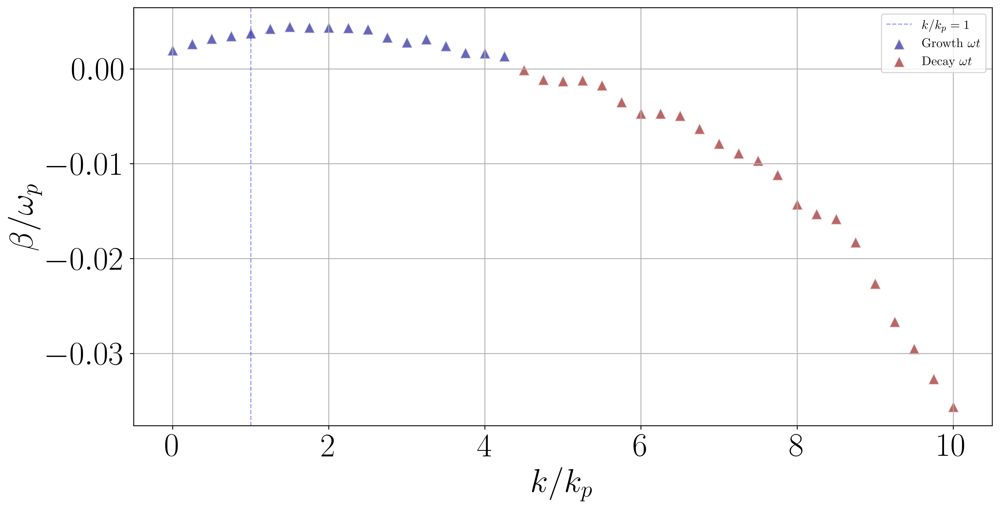

In [17]:
fig, ax = plt.subplots(figsize=(14, 7))
plt.scatter([k/4 for k in k_growth], [beta/omegap for beta in beta_growth], c='darkblue', marker= "^", label=r'Growth $\omega t$', alpha=0.6, edgecolors='w', s=100)
plt.scatter([k/4 for k in k_decay], [beta/omegap for beta in beta_decay], c='darkred', marker= "^", label=r'Decay $\omega t$ ', alpha=0.6, edgecolors='w', s=100)
# Añadir etiquetas y título
plt.xlabel(r'$k/k_p$')
plt.ylabel(r'$\beta / \omega_{p}$')
#plt.title(f'Growth and Decay Rates by Wavenumber ak = {ak}, u/c =0.5', fontsize=16)
plt.axvline(x=1, color='blue', linestyle='--', linewidth=1, alpha= 0.4,  label=r'$k/k_{p}=1$')
# Añadir leyenda
plt.legend()

# Añadir cuadrícula para mejor visualización
plt.grid(True)

# Ajustar límites si es necesario
#plt.xlim([-0.001, 10])

plt.savefig(f'/projects/DEIKE/cmartinb/graphs/2D_spectra/kpHs{kpHs}uoc{uoc}/beta.png')
# Mostrar el gráfico
plt.show()

#### Save betas in Data Frame so we can compare different cases

In [18]:
import pandas as pd
import numpy as np

# Creation Df for growth and decay
df_growth = pd.DataFrame({
    'Tipo': 'Growth',
    'Beta': beta_growth,
    'k': k_growth
})

df_decay = pd.DataFrame({
    'Tipo': 'Decay',
    'Beta': beta_decay,
    'k': k_decay
})

df_beta = pd.concat([df_growth, df_decay], axis=0).reset_index(drop=True)

# Guardar el DataFrame combinado en un archivo CSV
df_beta.to_csv(f'/projects/DEIKE/cmartinb/betas/betas_re{reA}_bo0{Bo}_P{kpHs}_uoc{uoc}_reW{reW}_L{maxLevel}.csv', index=False)

In [19]:
print(f'/projects/DEIKE/cmartinb/betas/betas_re{reA}_bo0{Bo}_P{kpHs}_uoc{uoc}_reW{reW}_L{maxLevel}.csv')

/projects/DEIKE/cmartinb/betas/betas_re720_bo0200_P0p08_uoc0p50_reW2.5e4_L10.csv


#### Different modes

x minimo -1893.480658010035
7
0.0


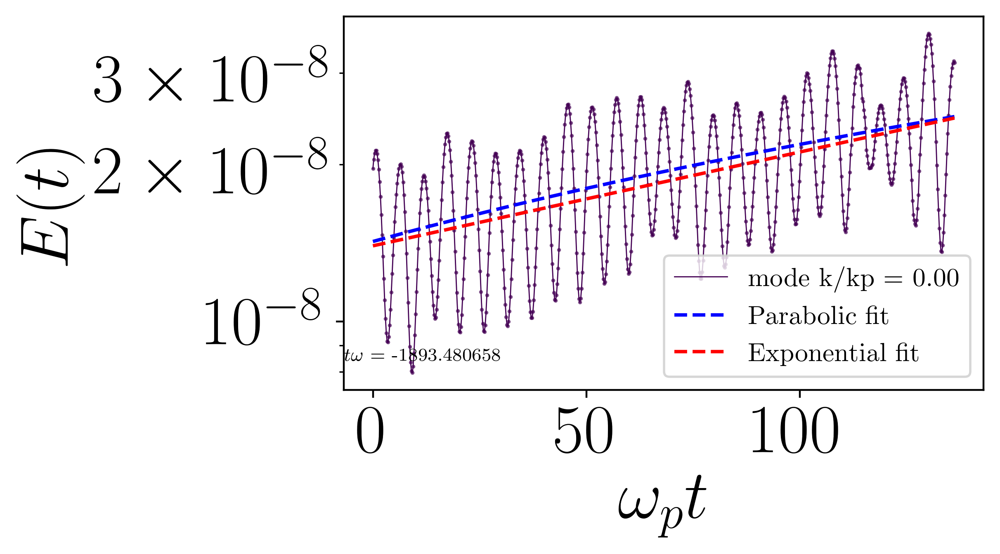

Parabolic fit: k/kp = 0.00,SSE = 1.71e-14, R^2 = 0.27159 time where behaviour changes $\omega t$ -1893.480658010035
RMSE of parabolic fit: 0.00000
a 1.397043676413924e-08 b 0.004144406259074905
[0.004144406259074905] [] [0.0] []


<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 0.00, slope = 0.00414, SSE = 1.75e-14, R^2 = 0.25796
1
0.25
[0.004144406259074905, 0.005331804700260806] [] [0.0, 0.25] []


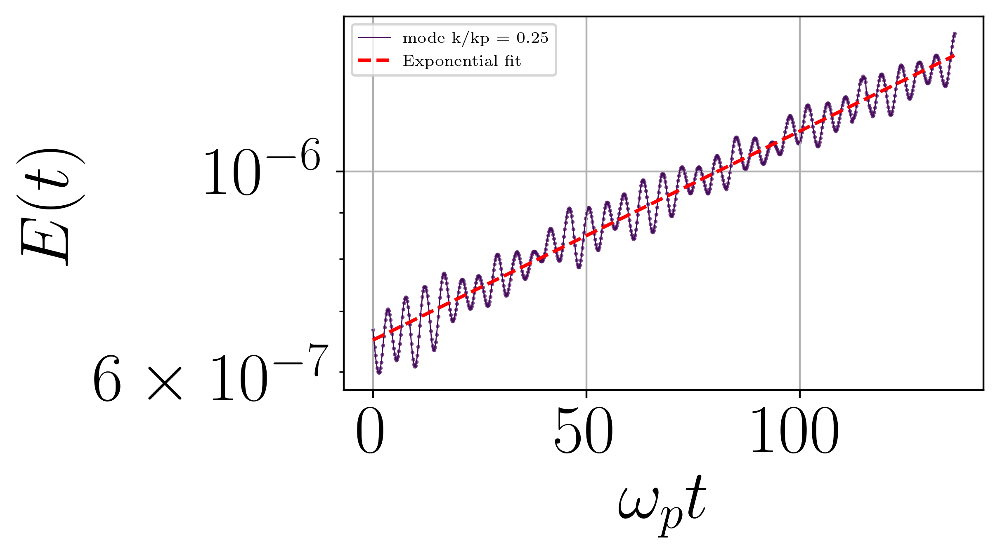

Exponential fit: k/kp = 0.25, slope = 0.00533, SSE = 9.71e-13, R^2 = 0.96556
1
0.5
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681] [] [0.0, 0.25, 0.5] []


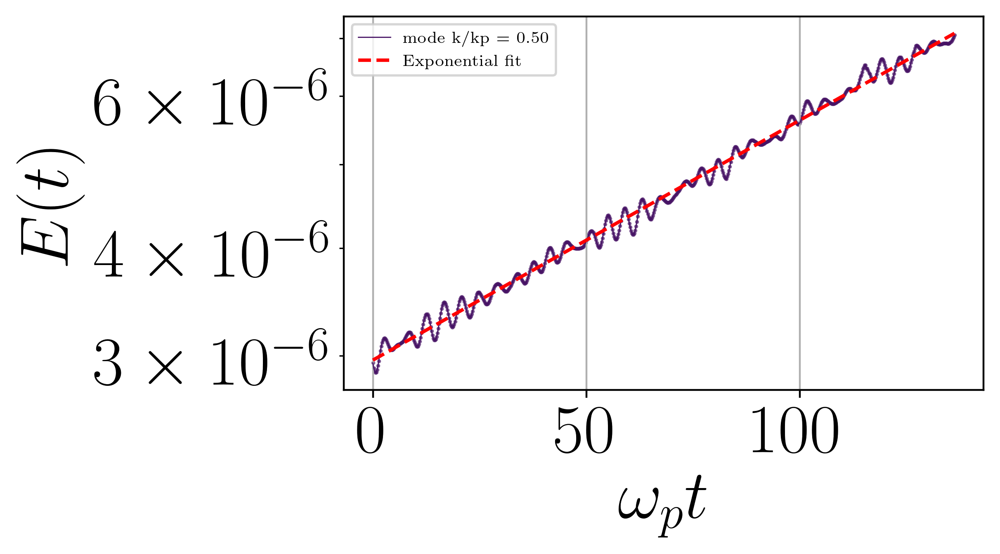

Exponential fit: k/kp = 0.50, slope = 0.00640, SSE = 5.91e-12, R^2 = 0.99401
1
0.75
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279] [] [0.0, 0.25, 0.5, 0.75] []


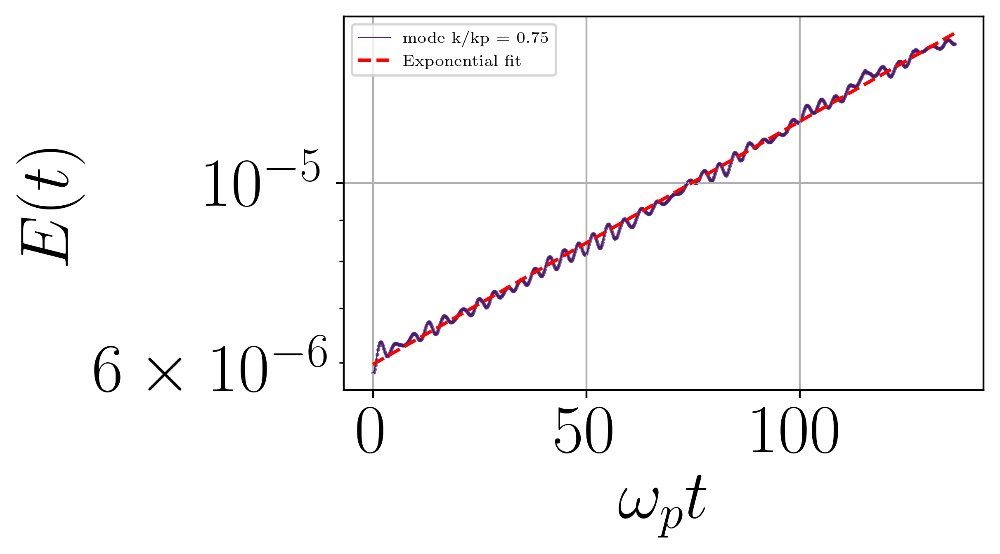

Exponential fit: k/kp = 0.75, slope = 0.00690, SSE = 1.58e-11, R^2 = 0.99686
1
1.0
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729] [] [0.0, 0.25, 0.5, 0.75, 1.0] []


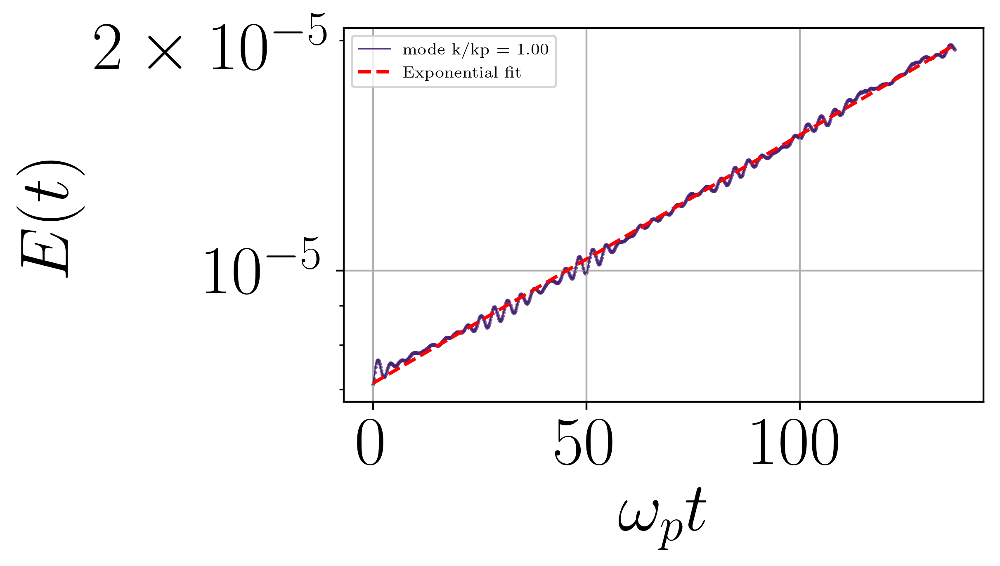

Exponential fit: k/kp = 1.00, slope = 0.00747, SSE = 1.73e-11, R^2 = 0.99812
1
1.25
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25] []


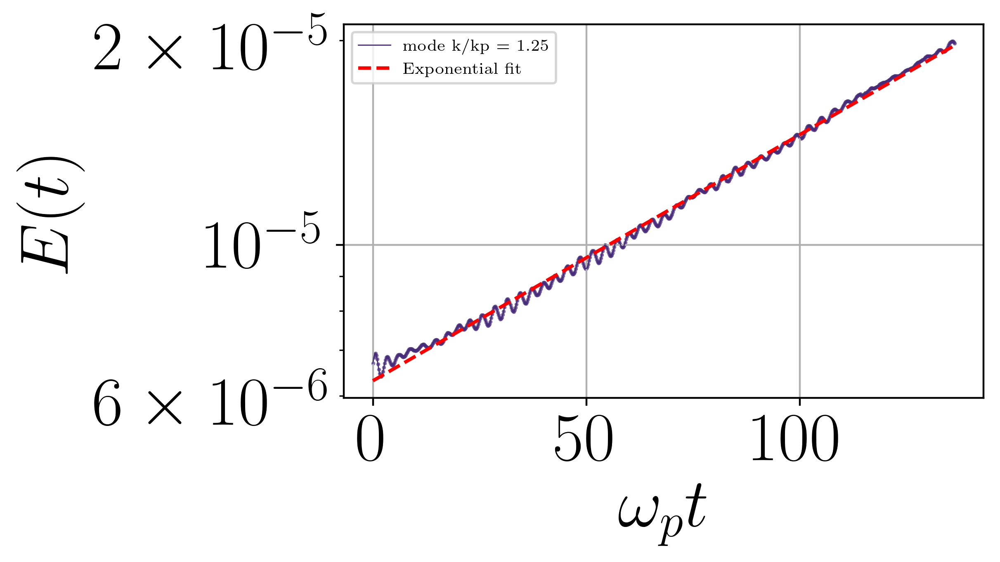

Exponential fit: k/kp = 1.25, slope = 0.00834, SSE = 2.32e-11, R^2 = 0.99778
1
1.5
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5] []


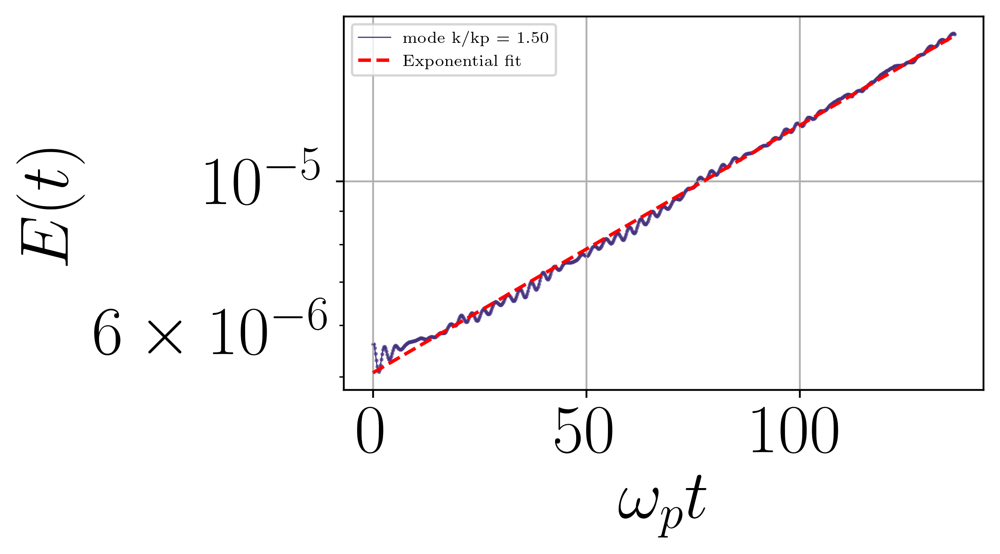

Exponential fit: k/kp = 1.50, slope = 0.00878, SSE = 1.31e-11, R^2 = 0.99835
1
1.75
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75] []


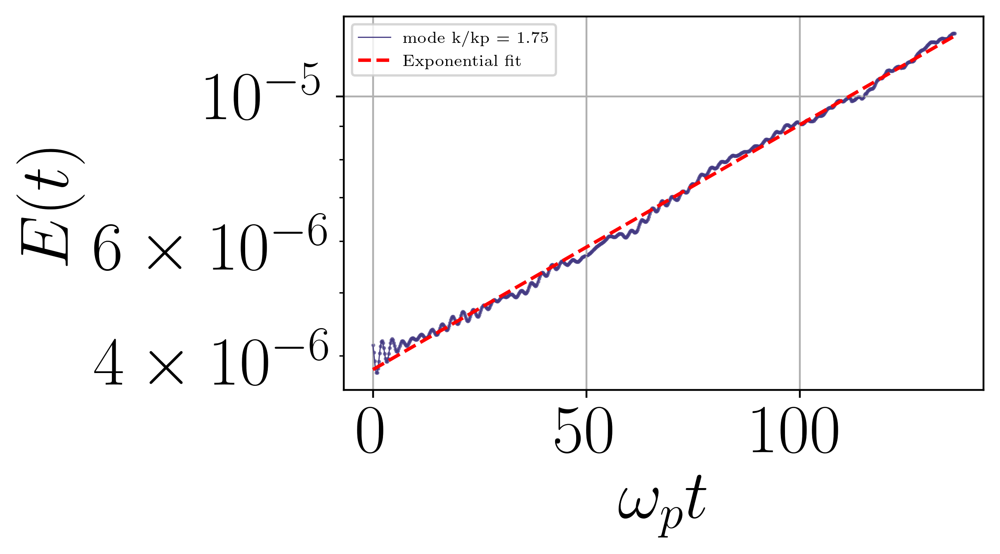

Exponential fit: k/kp = 1.75, slope = 0.00865, SSE = 1.20e-11, R^2 = 0.99717
1
2.0
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0] []


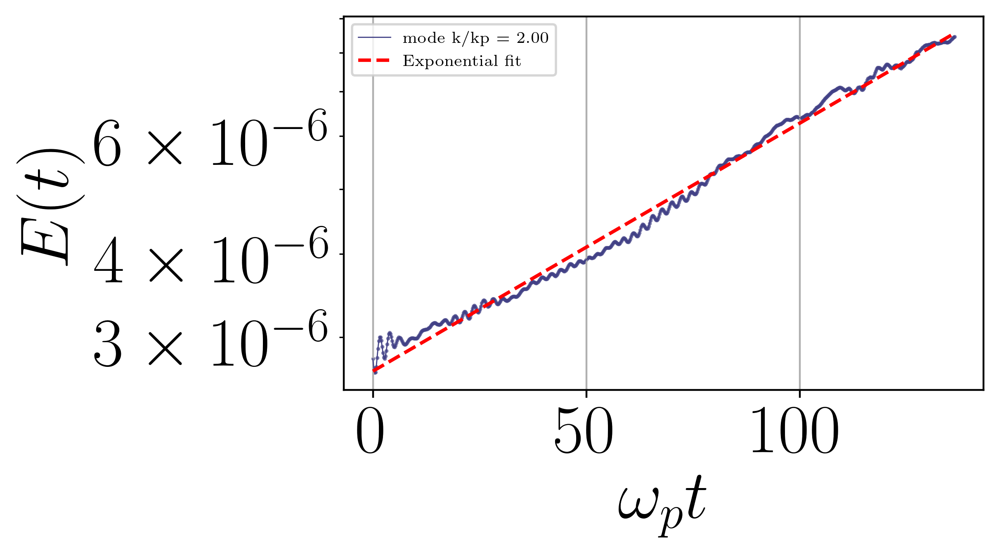

Exponential fit: k/kp = 2.00, slope = 0.00855, SSE = 1.35e-11, R^2 = 0.99344
1
2.25
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25] []


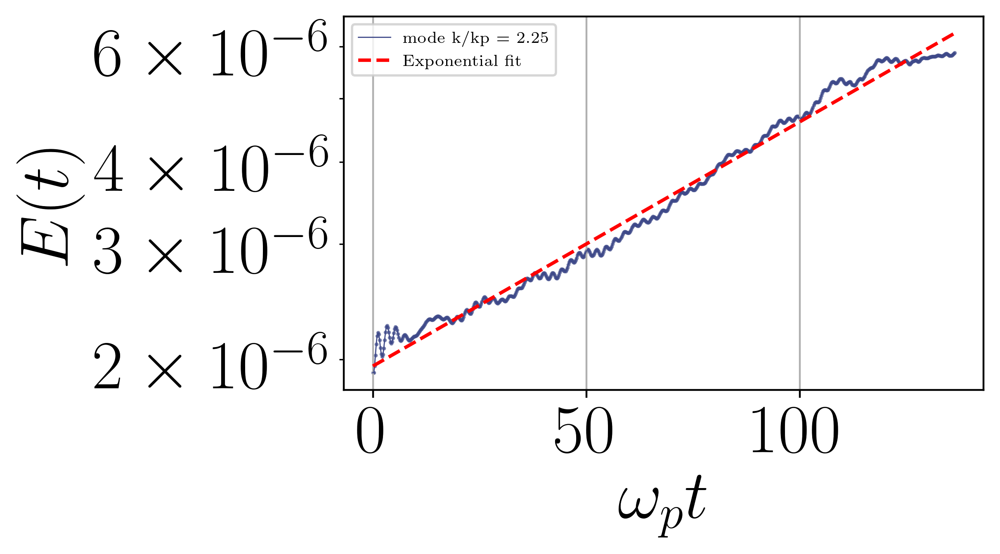

Exponential fit: k/kp = 2.25, slope = 0.00857, SSE = 1.53e-11, R^2 = 0.98616
1
2.5
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5] []


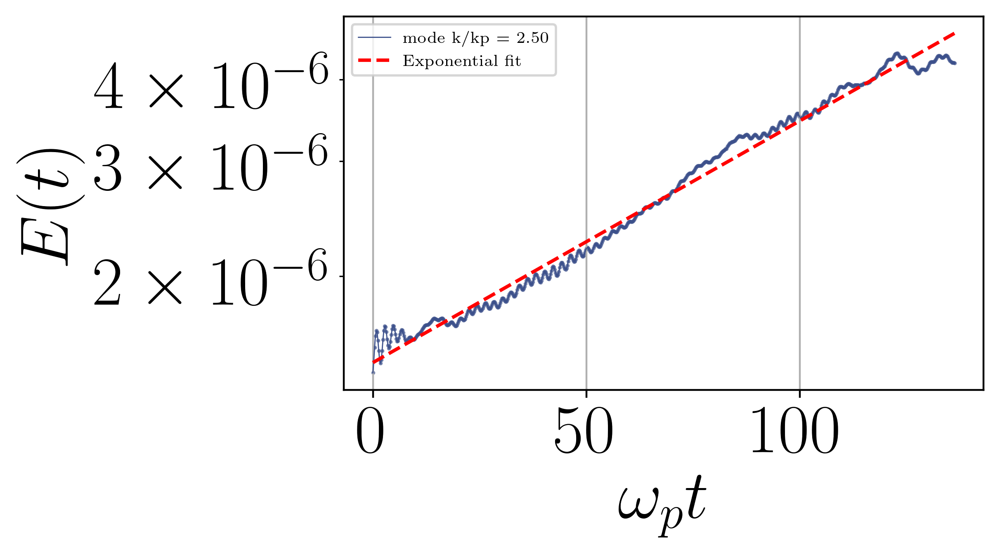

Exponential fit: k/kp = 2.50, slope = 0.00852, SSE = 8.90e-12, R^2 = 0.98486
1
2.75
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75] []


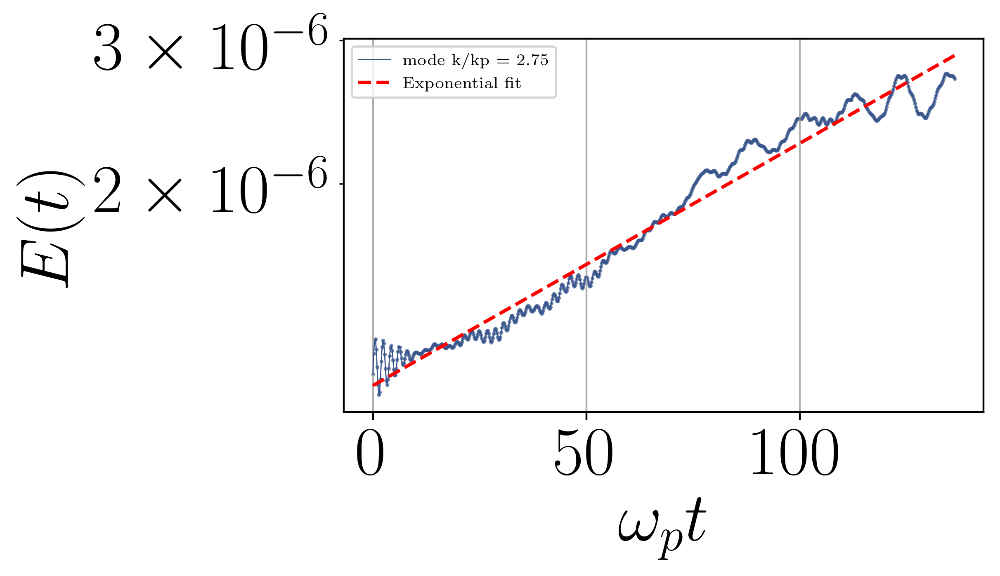

Exponential fit: k/kp = 2.75, slope = 0.00685, SSE = 6.65e-12, R^2 = 0.96180
1
3.0
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.0] []


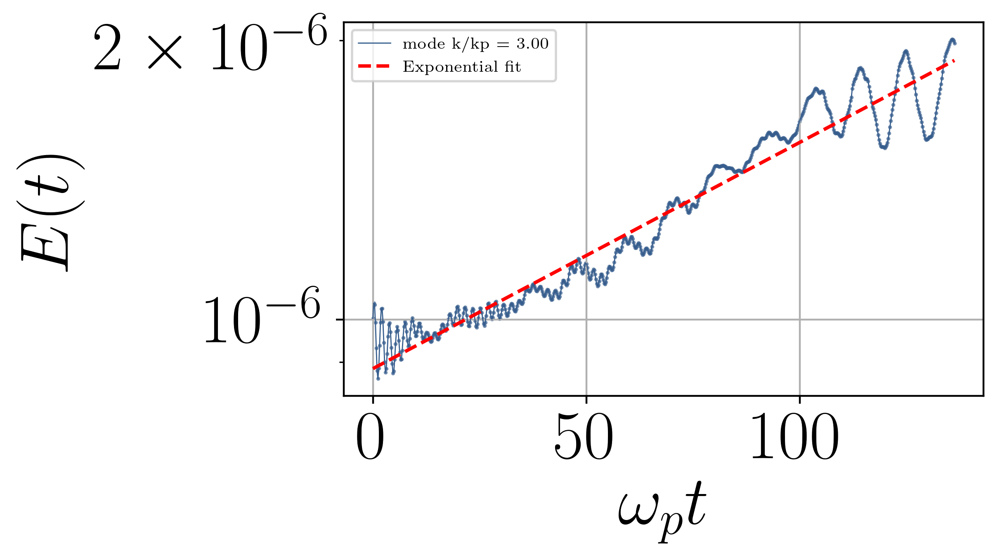

Exponential fit: k/kp = 3.00, slope = 0.00561, SSE = 4.73e-12, R^2 = 0.92725
1
3.25
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.0, 3.25] []


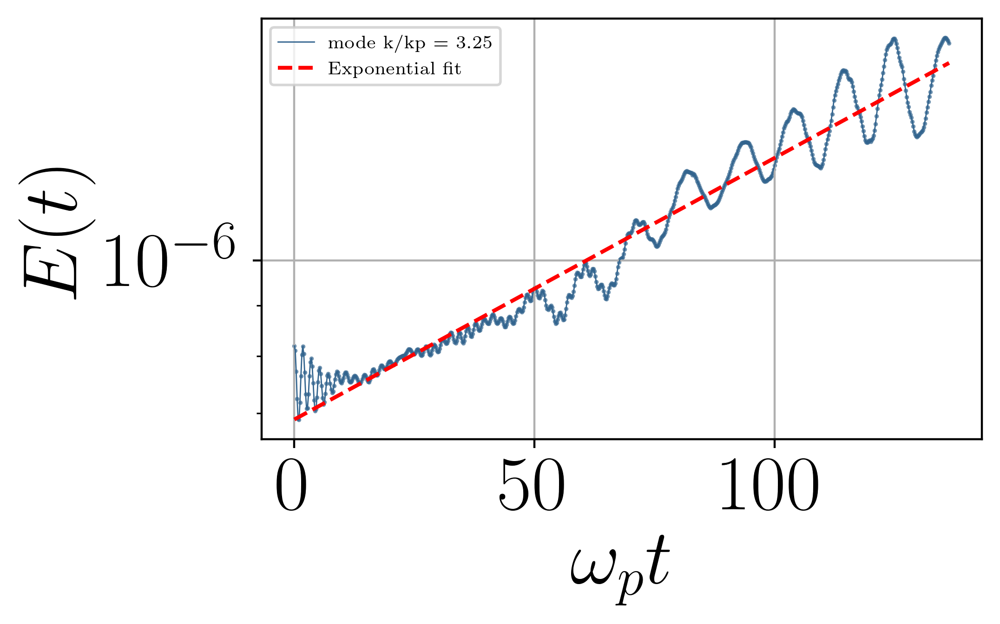

Exponential fit: k/kp = 3.25, slope = 0.00612, SSE = 3.14e-12, R^2 = 0.93887
1
3.5
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5] []


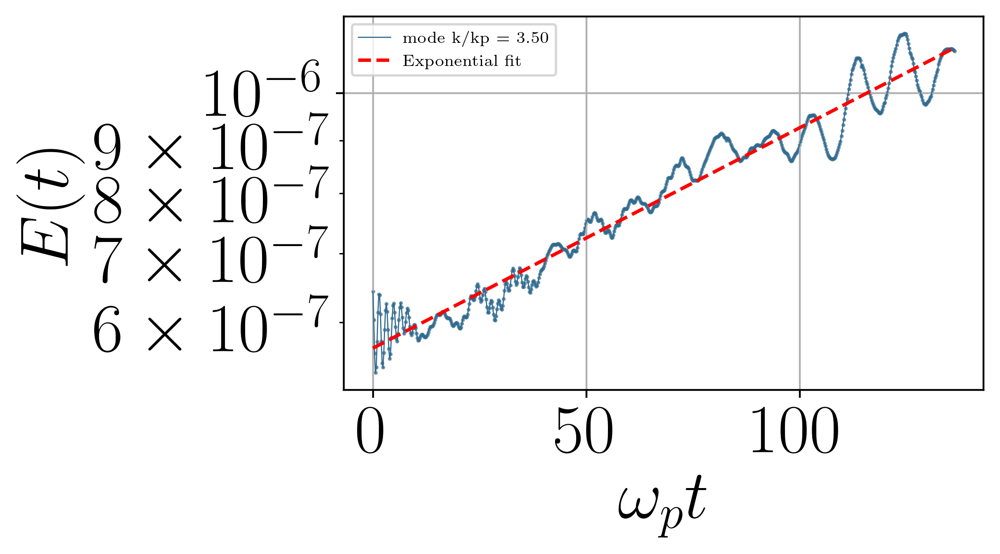

Exponential fit: k/kp = 3.50, slope = 0.00491, SSE = 9.53e-13, R^2 = 0.94560
1
3.75
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5, 3.75] []


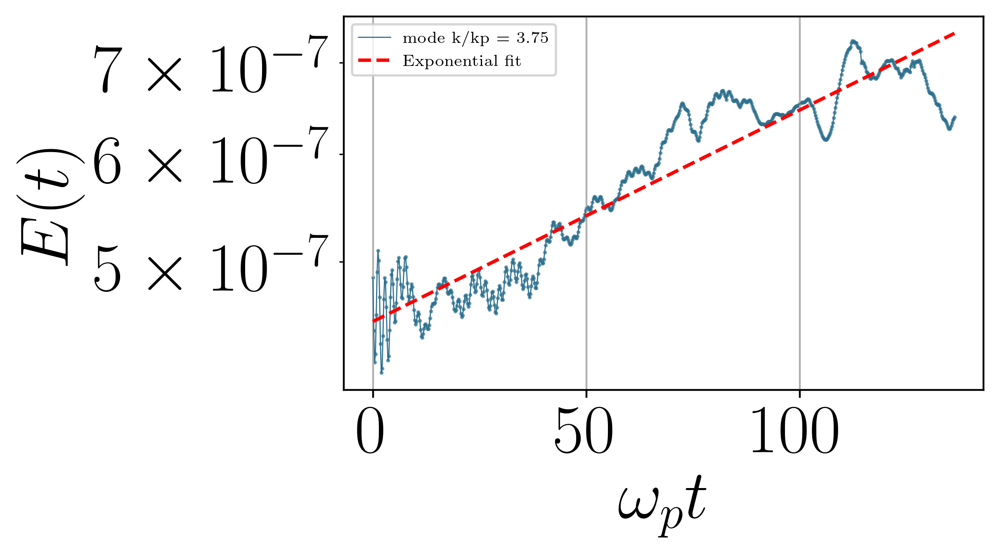

Exponential fit: k/kp = 3.75, slope = 0.00357, SSE = 7.02e-13, R^2 = 0.86095
x minimo -89.53440594673644
7
4.0


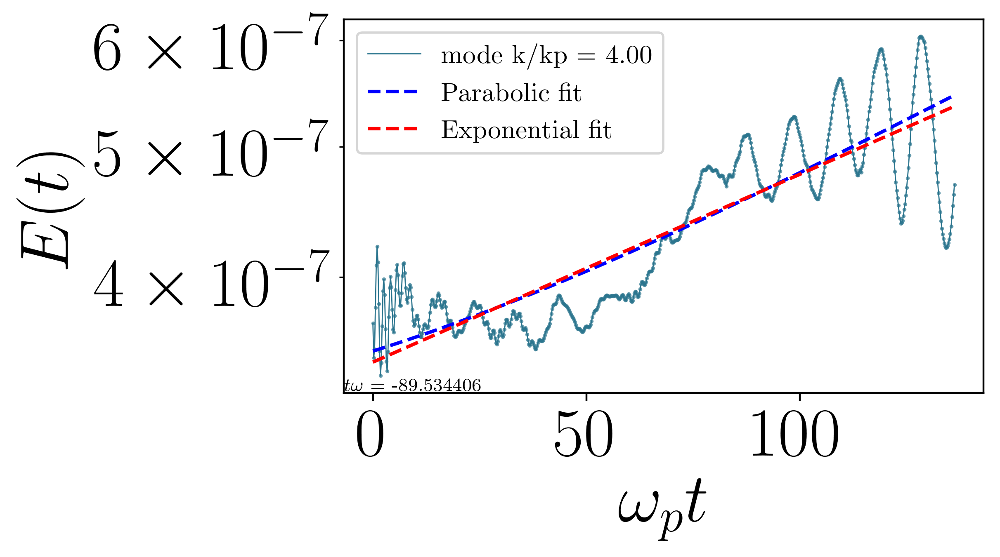

Parabolic fit: k/kp = 4.00,SSE = 8.72e-13, R^2 = 0.71667 time where behaviour changes $\omega t$ -89.53440594673644
RMSE of parabolic fit: 0.00000
a 3.458591782689875e-07 b 0.003213255364883775
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775] [] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5, 3.75, 4.0] []


<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 4.00, slope = 0.00321, SSE = 8.85e-13, R^2 = 0.71253
x minimo 46.43159530941274


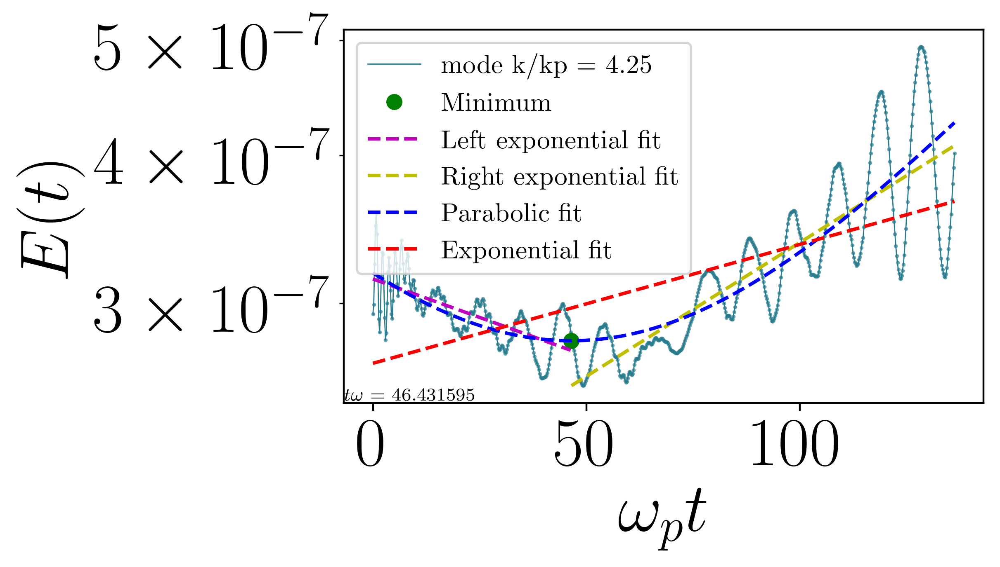

Parabolic fit: k/kp = 4.25,SSE = 5.62e-13, R^2 = 0.66613 time where behaviour changes $\omega t$ 46.43159530941274
RMSE of parabolic fit: 0.00000
a 2.6699422345569817e-07 b 0.002309046551000722
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537] [-0.0029886704447841883] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5, 3.75, 4.0, 4.25] [4.25]


<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 4.25, slope = 0.00231, SSE = 9.77e-13, R^2 = 0.42023
x minimo 69.77773920206961


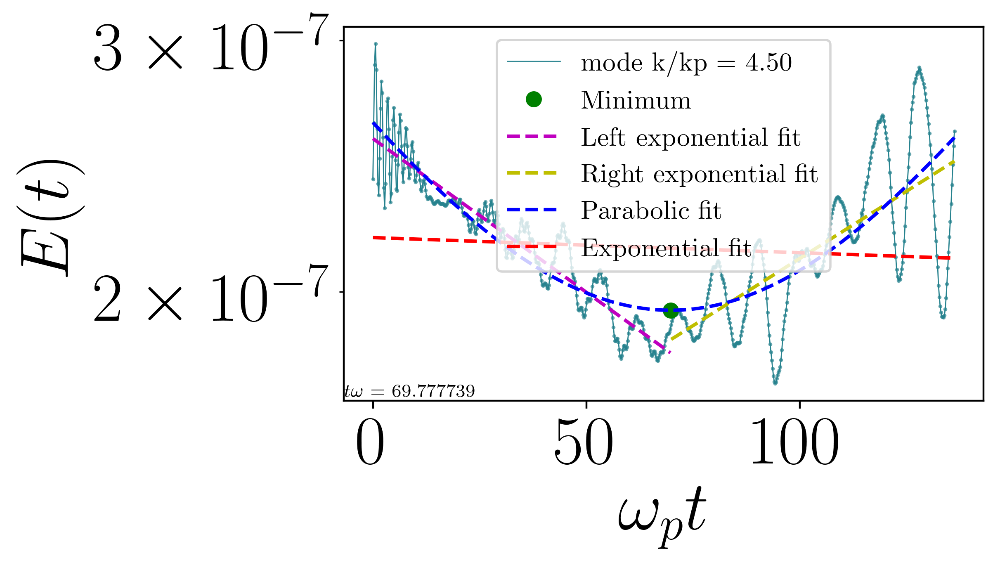

Parabolic fit: k/kp = 4.50,SSE = 1.64e-13, R^2 = 0.62026 time where behaviour changes $\omega t$ 69.77773920206961
RMSE of parabolic fit: 0.00000
a 2.1828065766352508e-07 b -0.00024347613837182703
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101] [-0.0029886704447841883, -0.004951534257230859] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5, 3.75, 4.0, 4.25, 4.5] [4.25, 4.5]


<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 4.50, slope = -0.00024, SSE = 4.32e-13, R^2 = 0.00278
x minimo 92.98801461441947


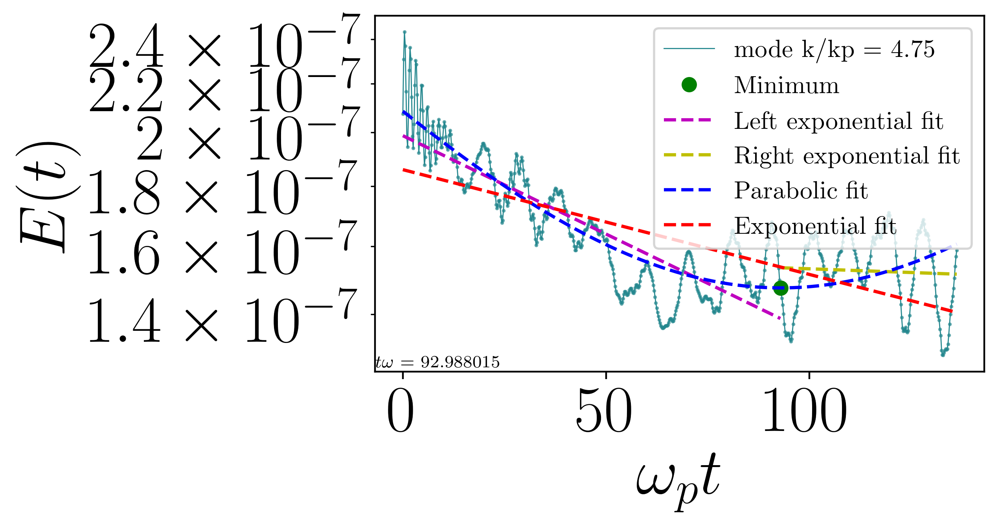

Parabolic fit: k/kp = 4.75,SSE = 7.22e-14, R^2 = 0.73426 time where behaviour changes $\omega t$ 92.98801461441947
RMSE of parabolic fit: 0.00000
a 1.8589767744138244e-07 b -0.0020536688660154636
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5, 3.75, 4.0, 4.25, 4.5] [4.25, 4.5, 18, 4.75, 4.75]


<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 4.75, slope = -0.00205, SSE = 1.33e-13, R^2 = 0.50987
x minimo 94.08604299416282


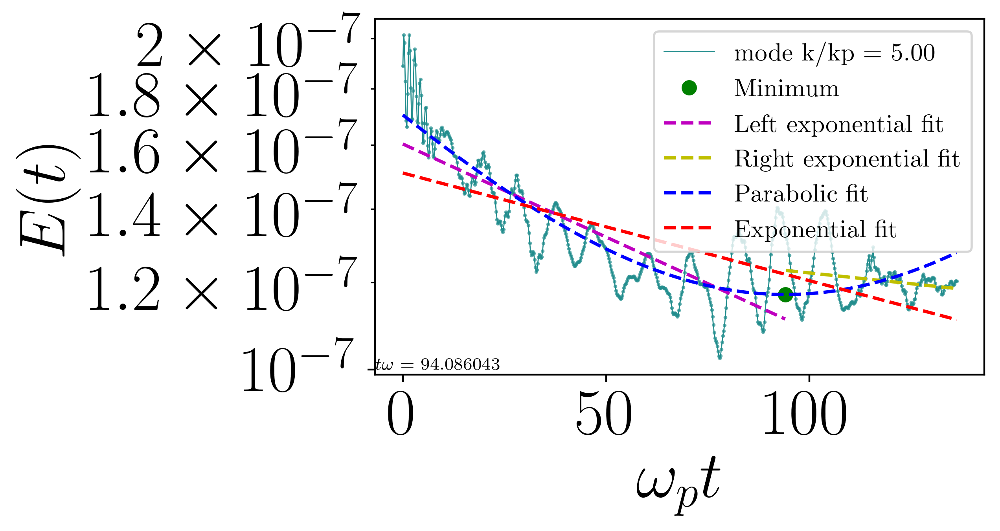

Parabolic fit: k/kp = 5.00,SSE = 4.73e-14, R^2 = 0.76546 time where behaviour changes $\omega t$ 94.08604299416282
RMSE of parabolic fit: 0.00000
a 1.5089959915806652e-07 b -0.0022534169980364394
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5, 3.75, 4.0, 4.25, 4.5] [4.25, 4.5, 18, 4.75, 4.75, 19, 5.0, 5.0]


<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 5.00, slope = -0.00225, SSE = 9.13e-14, R^2 = 0.54689
x minimo 78.90645835746554


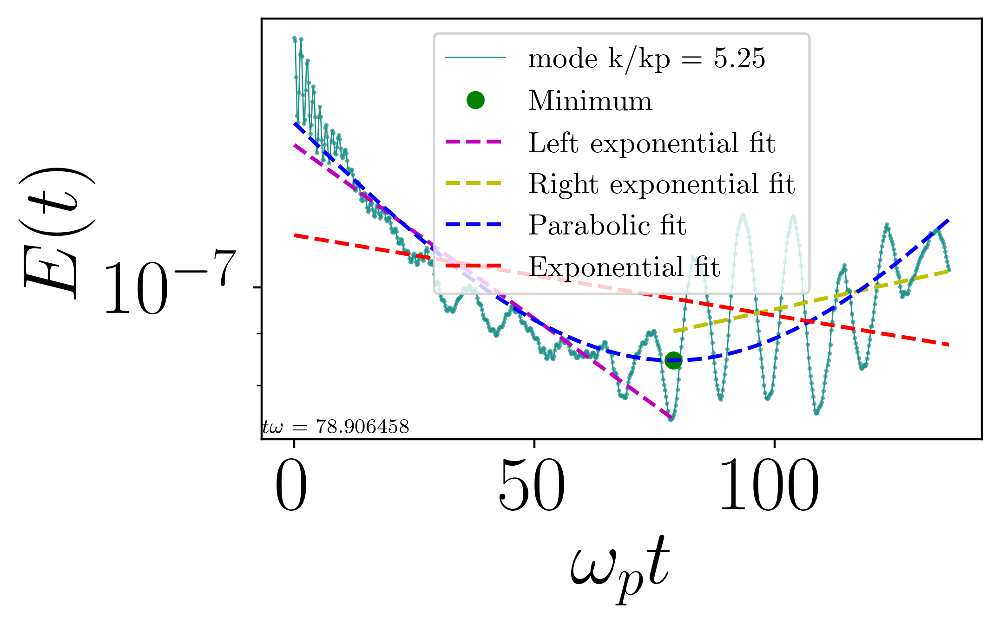

Parabolic fit: k/kp = 5.25,SSE = 6.57e-14, R^2 = 0.72660 time where behaviour changes $\omega t$ 78.90645835746554
RMSE of parabolic fit: 0.00000
a 1.1256177557493774e-07 b -0.0018285514270317367
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934, -0.007908484637622058] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5, 3.75, 4.0, 4.25, 4.5, 5.25] [4.25, 4.5, 18, 4.75, 4.75, 19, 5.0, 5.0, 20, 5.25]


<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 5.25, slope = -0.00183, SSE = 1.91e-13, R^2 = 0.20756
x minimo 78.51005114044673


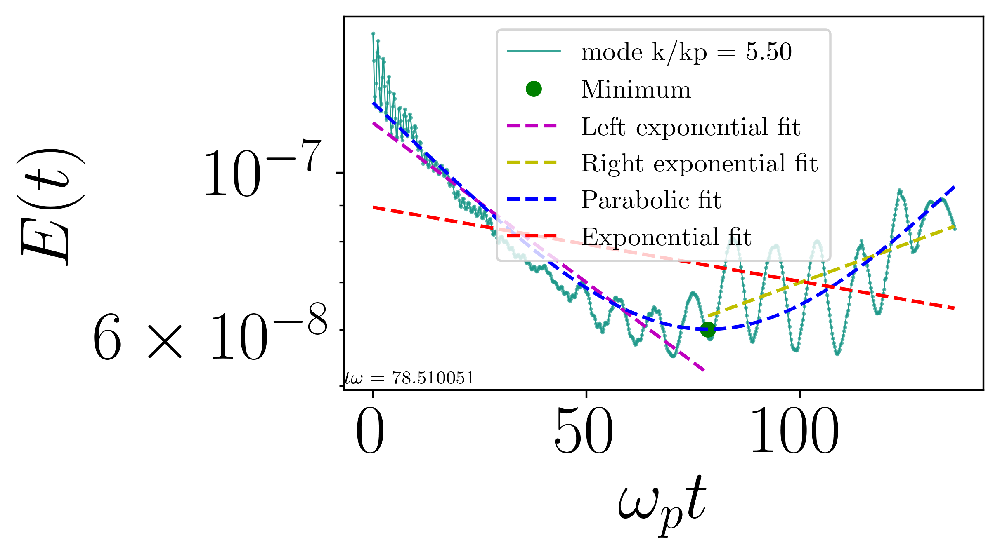

Parabolic fit: k/kp = 5.50,SSE = 3.54e-14, R^2 = 0.85250 time where behaviour changes $\omega t$ 78.51005114044673
RMSE of parabolic fit: 0.00000
a 8.94171631219061e-08 b -0.0024123074258757854
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934, -0.007908484637622058, -0.010391955867462156] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5, 3.75, 4.0, 4.25, 4.5, 5.25, 5.5] [4.25, 4.5, 18, 4.75, 4.75, 19, 5.0, 5.

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 5.50, slope = -0.00241, SSE = 1.84e-13, R^2 = 0.23221
x minimo 87.83024899627635


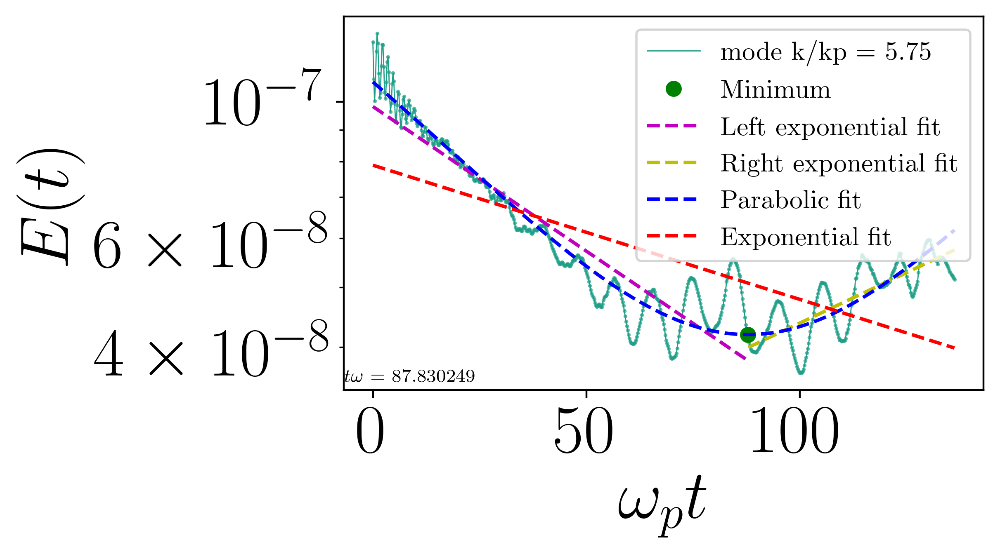

Parabolic fit: k/kp = 5.75,SSE = 1.43e-14, R^2 = 0.93861 time where behaviour changes $\omega t$ 87.83024899627635
RMSE of parabolic fit: 0.00000
a 7.889868740494064e-08 b -0.0050140203395690275
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934, -0.007908484637622058, -0.010391955867462156, -0.010806112011414454] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5, 3.75, 4.0, 4.25, 4.5, 5.25

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 5.75, slope = -0.00501, SSE = 1.00e-13, R^2 = 0.57156
x minimo 91.53215485046339


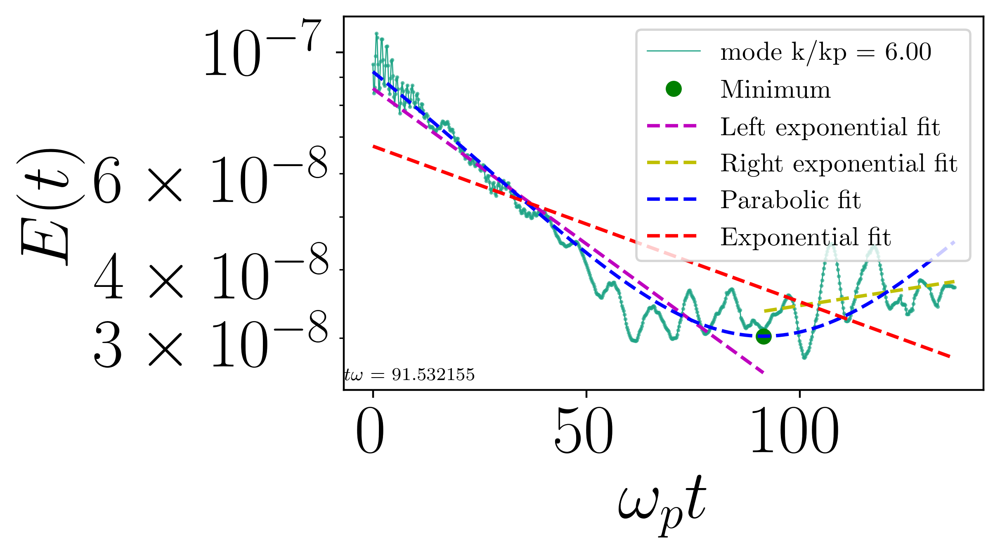

Parabolic fit: k/kp = 6.00,SSE = 1.25e-14, R^2 = 0.94190 time where behaviour changes $\omega t$ 91.53215485046339
RMSE of parabolic fit: 0.00000
a 6.729938750354097e-08 b -0.006560617833223309
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934, -0.007908484637622058, -0.010391955867462156, -0.010806112011414454, -0.013102917420281171] [0.0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 2.75

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 6.00, slope = -0.00656, SSE = 7.25e-14, R^2 = 0.66216
x minimo 86.67744436142485


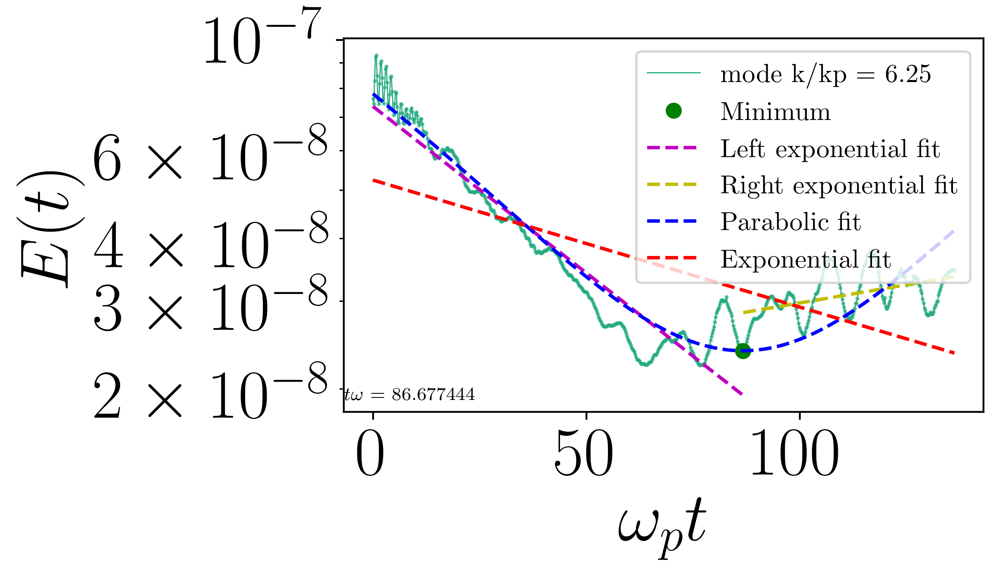

Parabolic fit: k/kp = 6.25,SSE = 1.24e-14, R^2 = 0.92187 time where behaviour changes $\omega t$ 86.67744436142485
RMSE of parabolic fit: 0.00000
a 5.236744051966397e-08 b -0.005860045619023516
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934, -0.007908484637622058, -0.010391955867462156, -0.010806112011414454, -0.013102917420281171, -0.015372444148522225] [0.0, 0.25, 0.5, 0.75

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 6.25, slope = -0.00586, SSE = 7.56e-14, R^2 = 0.52513
x minimo 83.79457494448035


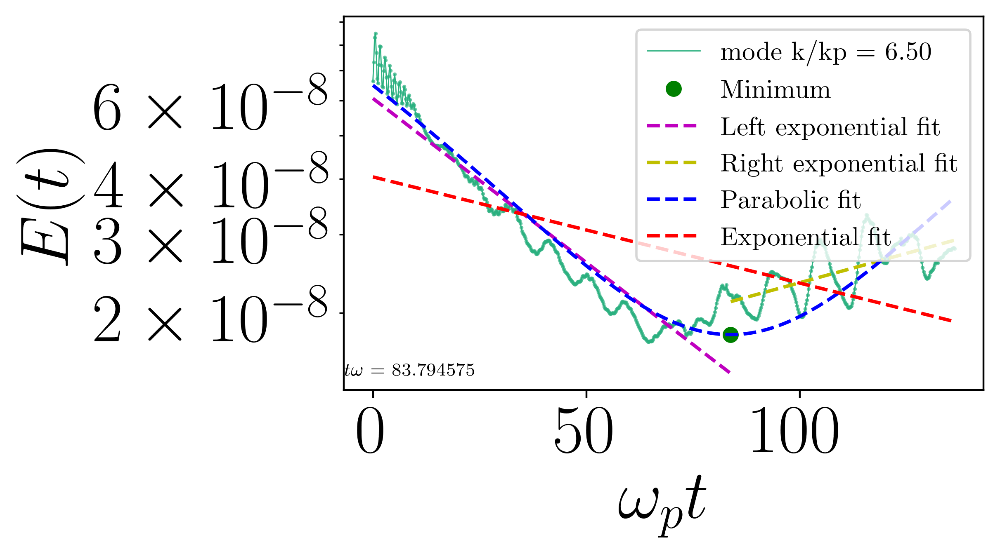

Parabolic fit: k/kp = 6.50,SSE = 1.14e-14, R^2 = 0.90427 time where behaviour changes $\omega t$ 83.79457494448035
RMSE of parabolic fit: 0.00000
a 4.0392479016427065e-08 b -0.005490475934333402
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934, -0.007908484637622058, -0.010391955867462156, -0.010806112011414454, -0.013102917420281171, -0.015372444148522225

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 6.50, slope = -0.00549, SSE = 6.87e-14, R^2 = 0.42250
x minimo 85.03408334021577


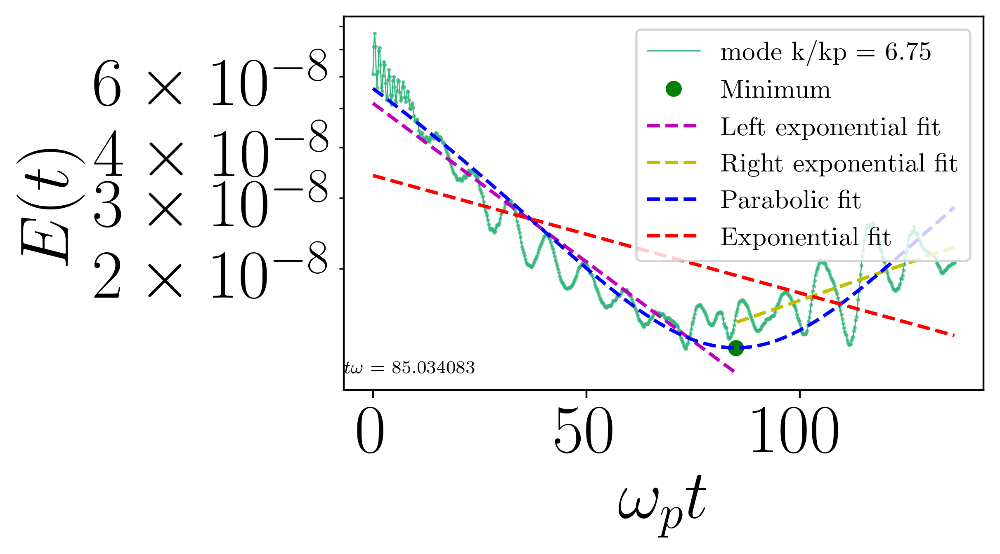

Parabolic fit: k/kp = 6.75,SSE = 9.39e-15, R^2 = 0.90760 time where behaviour changes $\omega t$ 85.03408334021577
RMSE of parabolic fit: 0.00000
a 3.408323566592739e-08 b -0.006714255246566957
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934, -0.007908484637622058, -0.010391955867462156, -0.010806112011414454, -0.013102917420281171, -

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 6.75, slope = -0.00671, SSE = 5.42e-14, R^2 = 0.46664
x minimo 85.84232062508471


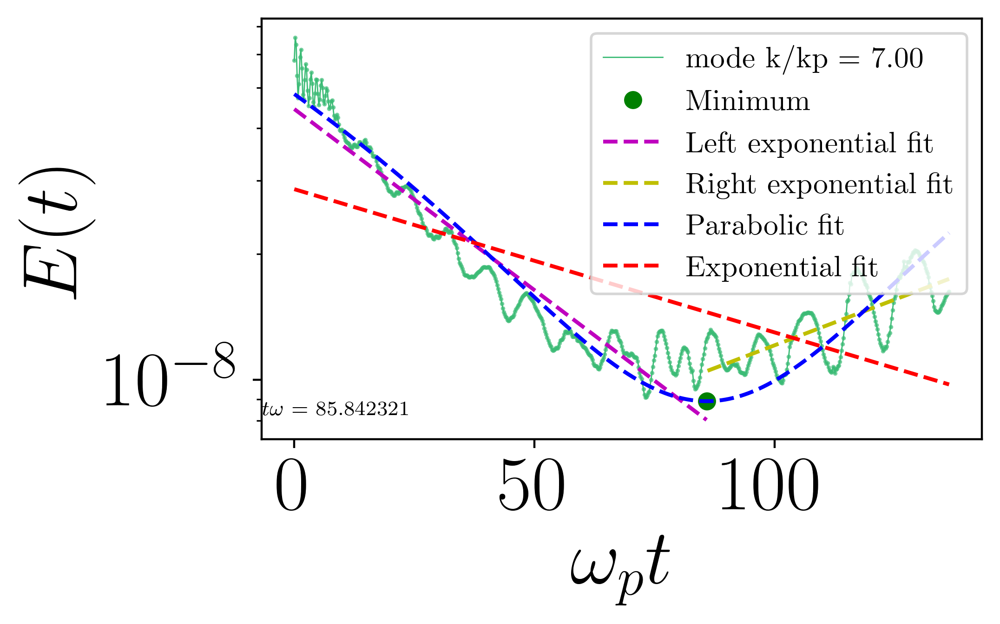

Parabolic fit: k/kp = 7.00,SSE = 6.31e-15, R^2 = 0.92411 time where behaviour changes $\omega t$ 85.84232062508471
RMSE of parabolic fit: 0.00000
a 2.8591140983850602e-08 b -0.007889665874060054
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934, -0.007908484637622058, -0.010391955867462156, -0.010806112011414454, -

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 7.00, slope = -0.00789, SSE = 4.15e-14, R^2 = 0.50140
x minimo 85.6190493931733


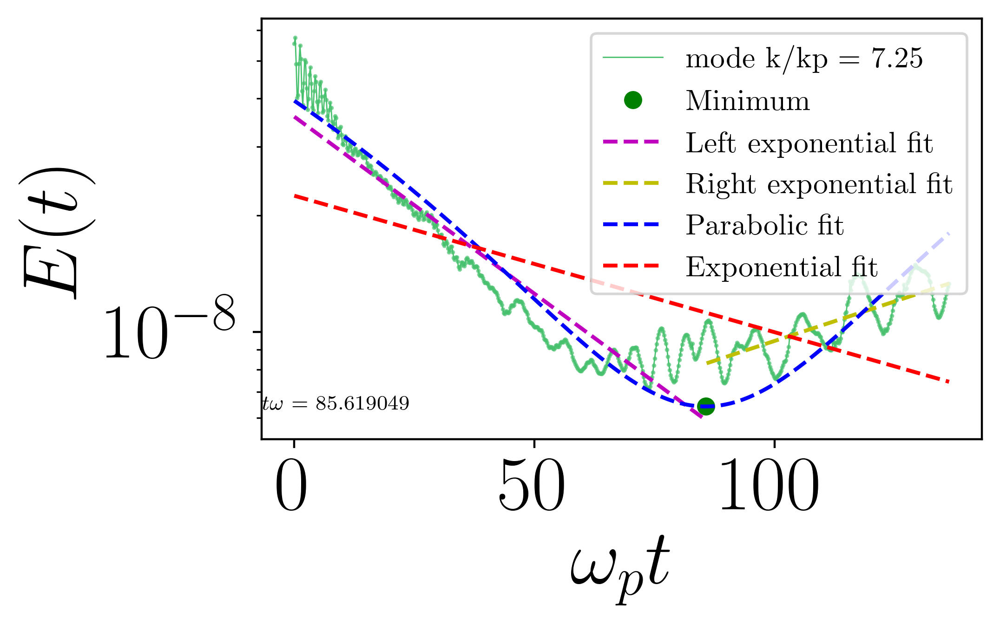

Parabolic fit: k/kp = 7.25,SSE = 5.53e-15, R^2 = 0.90715 time where behaviour changes $\omega t$ 85.6190493931733
RMSE of parabolic fit: 0.00000
a 2.245352709457417e-08 b -0.008107170896258366
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934, -0.007908484637622058, -0.010391955867462156, -0.0

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 7.25, slope = -0.00811, SSE = 3.12e-14, R^2 = 0.47552
x minimo 85.71139230123879


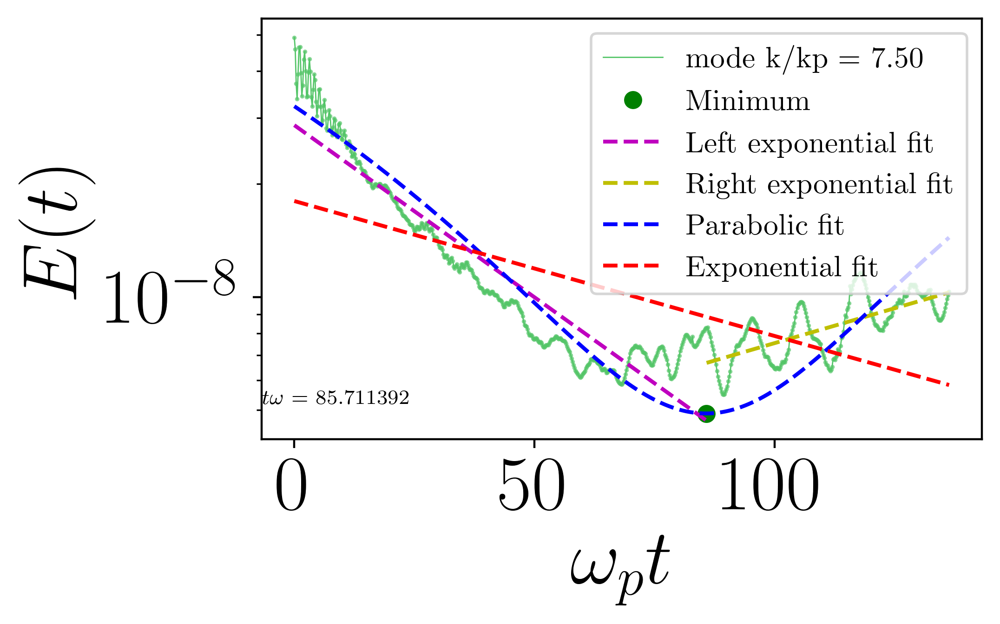

Parabolic fit: k/kp = 7.50,SSE = 5.12e-15, R^2 = 0.87846 time where behaviour changes $\omega t$ 85.71139230123879
RMSE of parabolic fit: 0.00000
a 1.8024020146029072e-08 b -0.008282765973376433
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915, 0.008562762037070168] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934, -0.007908484637622058, -0.

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 7.50, slope = -0.00828, SSE = 2.29e-14, R^2 = 0.45789
x minimo 84.81386182499979


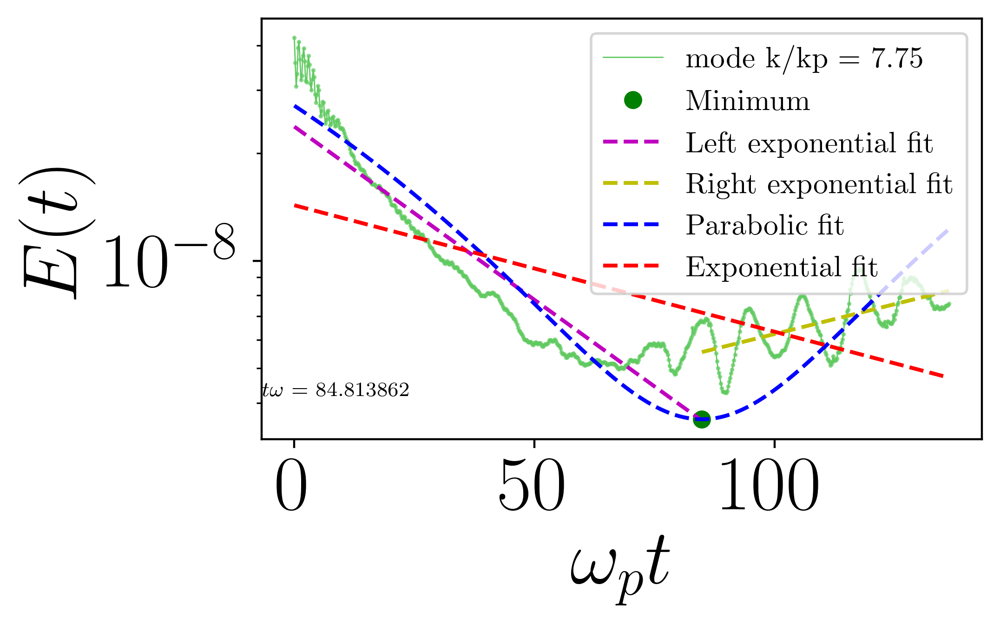

Parabolic fit: k/kp = 7.75,SSE = 4.93e-15, R^2 = 0.84667 time where behaviour changes $\omega t$ 84.81386182499979
RMSE of parabolic fit: 0.00000
a 1.4294601404305092e-08 b -0.008150211028349277
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915, 0.008562762037070168, 0.00769912701742822] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934, -0.00

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 7.75, slope = -0.00815, SSE = 1.92e-14, R^2 = 0.40220
x minimo 84.3146263319645


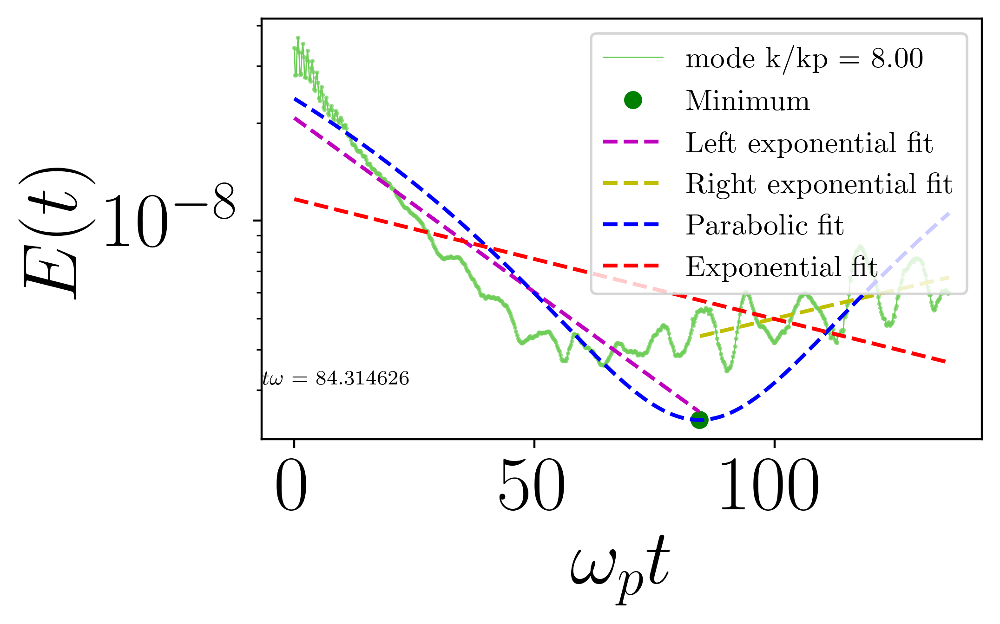

Parabolic fit: k/kp = 8.00,SSE = 4.23e-15, R^2 = 0.84070 time where behaviour changes $\omega t$ 84.3146263319645
RMSE of parabolic fit: 0.00000
a 1.1654796930969977e-08 b -0.008513892598941761
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915, 0.008562762037070168, 0.00769912701742822, 0.008048966655894276] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.00090

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 8.00, slope = -0.00851, SSE = 1.67e-14, R^2 = 0.36906
x minimo 84.461966856866


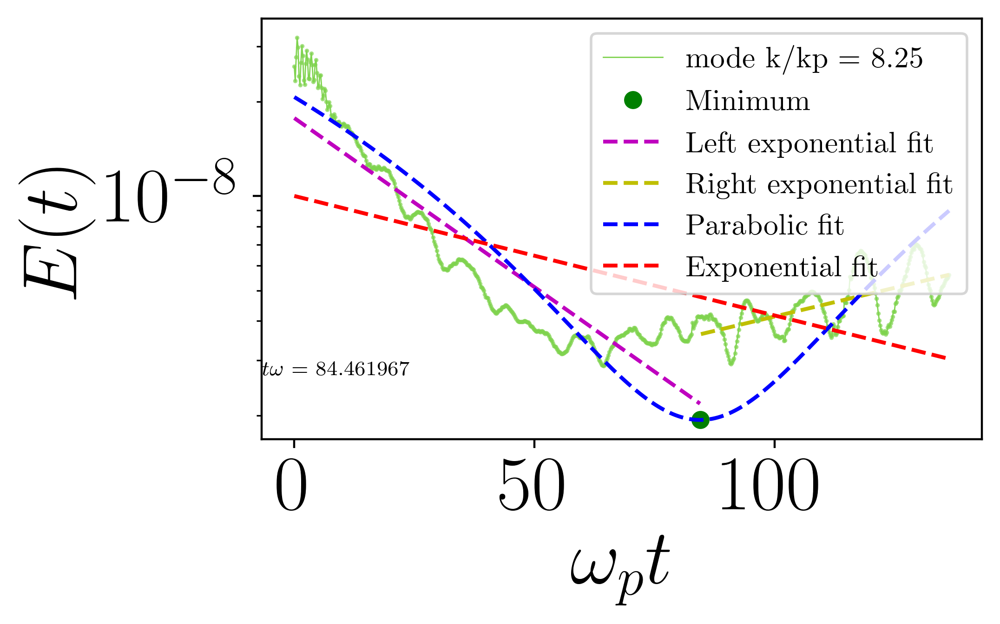

Parabolic fit: k/kp = 8.25,SSE = 3.33e-15, R^2 = 0.83778 time where behaviour changes $\omega t$ 84.461966856866
RMSE of parabolic fit: 0.00000
a 1.0005109738185244e-08 b -0.00876937513842034
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915, 0.008562762037070168, 0.00769912701742822, 0.008048966655894276, 0.008426129332261606] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.00389474

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 8.25, slope = -0.00877, SSE = 1.29e-14, R^2 = 0.36937
x minimo 84.33896048823449


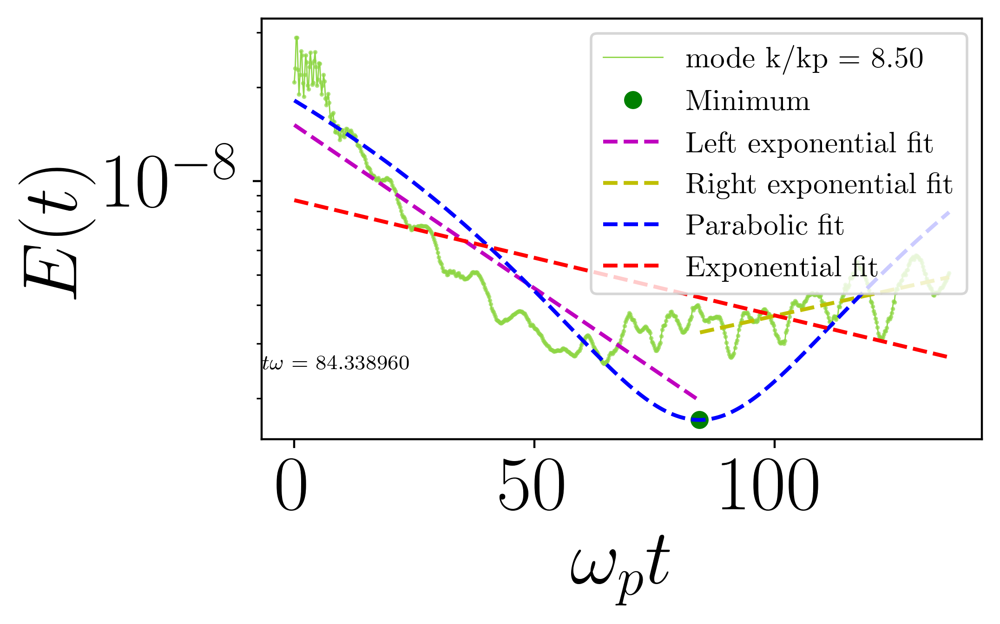

Parabolic fit: k/kp = 8.50,SSE = 3.00e-15, R^2 = 0.81515 time where behaviour changes $\omega t$ 84.33896048823449
RMSE of parabolic fit: 0.00000
a 8.680594206336997e-09 b -0.008530207519069376
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915, 0.008562762037070168, 0.00769912701742822, 0.008048966655894276, 0.008426129332261606, 0.007892390515807132] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.0002902

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 8.50, slope = -0.00853, SSE = 1.06e-14, R^2 = 0.34965
x minimo 83.35163893071137


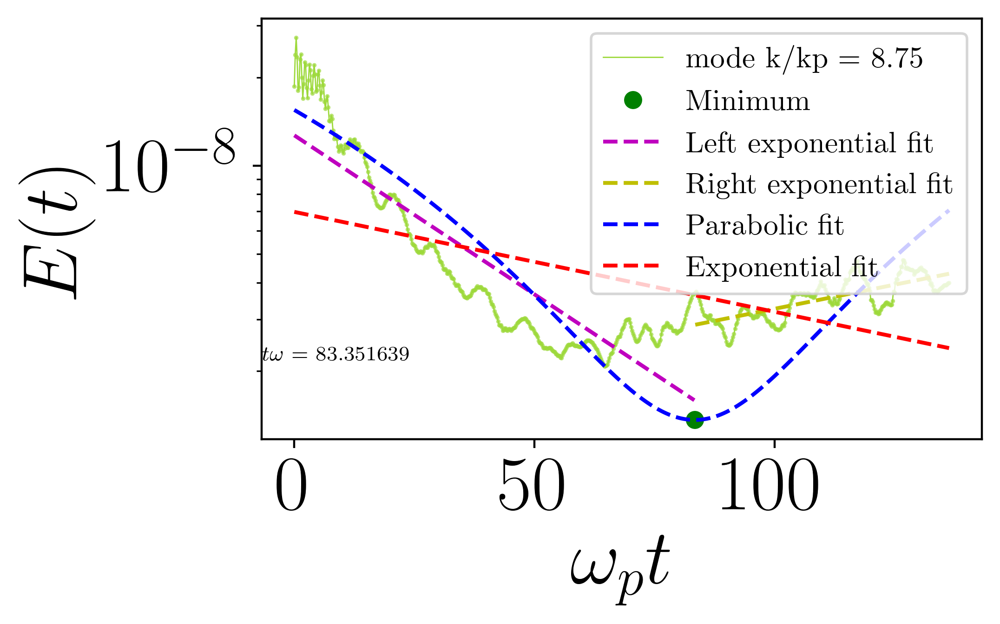

Parabolic fit: k/kp = 8.75,SSE = 2.71e-15, R^2 = 0.78087 time where behaviour changes $\omega t$ 83.35163893071137
RMSE of parabolic fit: 0.00000
a 6.965590028975715e-09 b -0.007834412468776114
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915, 0.008562762037070168, 0.00769912701742822, 0.008048966655894276, 0.008426129332261606, 0.007892390515807132, 0.00757028155852688] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 8.75, slope = -0.00783, SSE = 8.78e-15, R^2 = 0.29010
x minimo 82.15197095406661


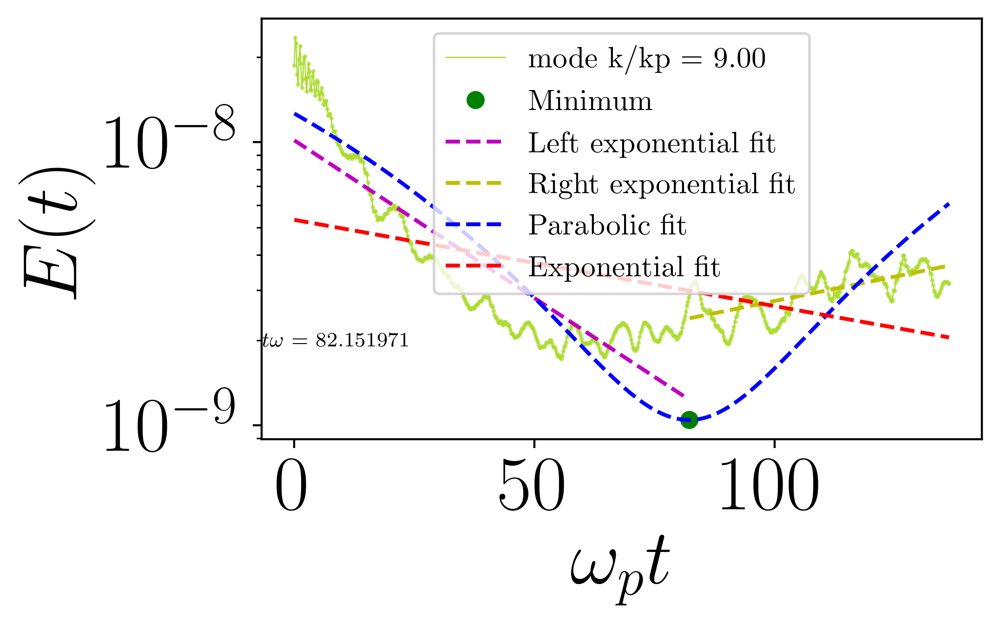

Parabolic fit: k/kp = 9.00,SSE = 2.29e-15, R^2 = 0.73796 time where behaviour changes $\omega t$ 82.15197095406661
RMSE of parabolic fit: 0.00000
a 5.319192443535479e-09 b -0.0070176772889228335
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915, 0.008562762037070168, 0.00769912701742822, 0.008048966655894276, 0.008426129332261606, 0.007892390515807132, 0.00757028155852688, 0.00793577825963073] [-0.0029886704447841883, -0.00495153425

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 9.00, slope = -0.00702, SSE = 6.75e-15, R^2 = 0.22631
x minimo 81.24349818066052


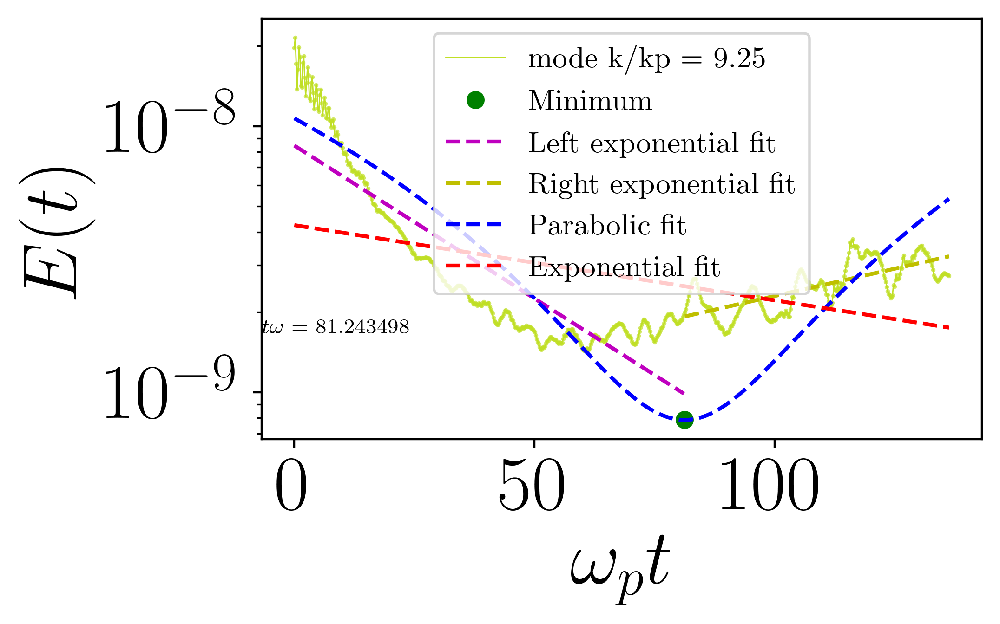

Parabolic fit: k/kp = 9.25,SSE = 1.86e-15, R^2 = 0.71582 time where behaviour changes $\omega t$ 81.24349818066052
RMSE of parabolic fit: 0.00000
a 4.244829918861106e-09 b -0.006507375210630306
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915, 0.008562762037070168, 0.00769912701742822, 0.008048966655894276, 0.008426129332261606, 0.007892390515807132, 0.00757028155852688, 0.00793577825963073, 0.009460819860207824] [-0.00298867044478

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 9.25, slope = -0.00651, SSE = 5.34e-15, R^2 = 0.18439
x minimo 80.31863241422795


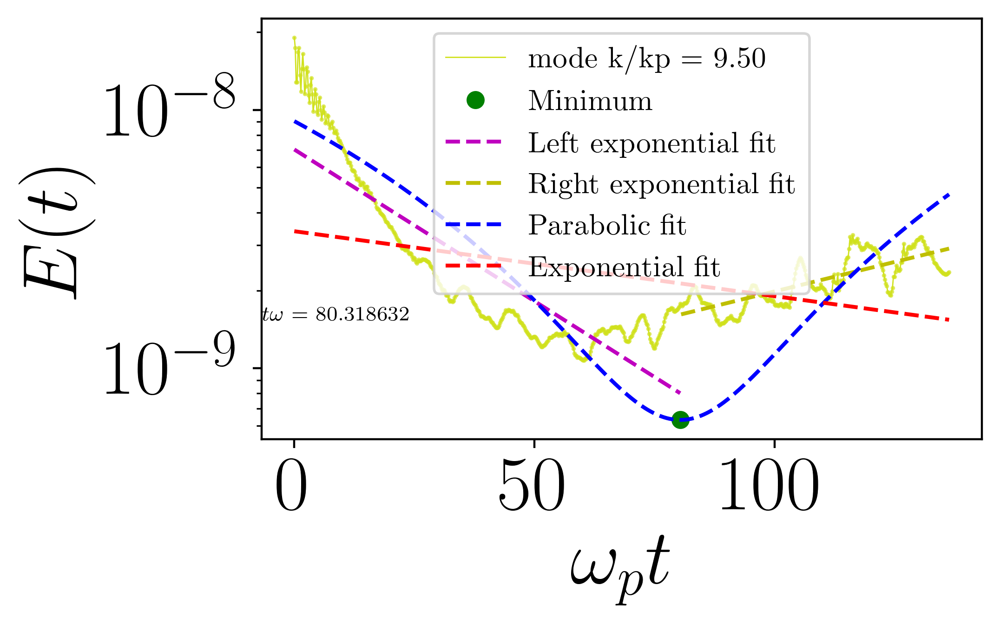

Parabolic fit: k/kp = 9.50,SSE = 1.46e-15, R^2 = 0.69713 time where behaviour changes $\omega t$ 80.31863241422795
RMSE of parabolic fit: 0.00000
a 3.3927453334420304e-09 b -0.005786805730438246
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915, 0.008562762037070168, 0.00769912701742822, 0.008048966655894276, 0.008426129332261606, 0.007892390515807132, 0.00757028155852688, 0.00793577825963073, 0.009460819860207824, 0.010507445556790

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 9.50, slope = -0.00579, SSE = 4.14e-15, R^2 = 0.14293
x minimo 79.93163672760859


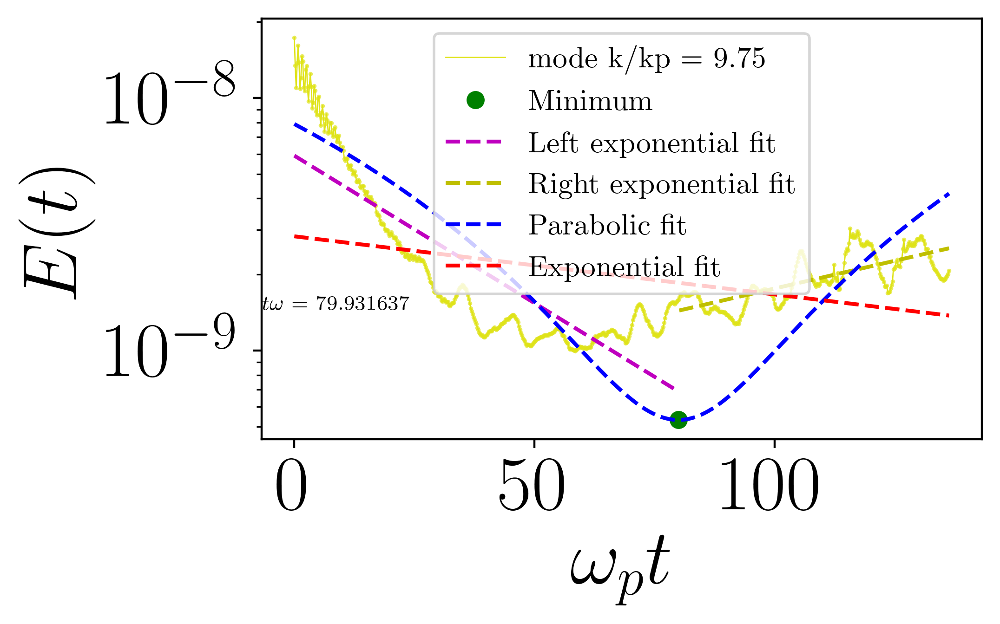

Parabolic fit: k/kp = 9.75,SSE = 1.27e-15, R^2 = 0.66829 time where behaviour changes $\omega t$ 79.93163672760859
RMSE of parabolic fit: 0.00000
a 2.8331949611512422e-09 b -0.005299207484435202
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915, 0.008562762037070168, 0.00769912701742822, 0.008048966655894276, 0.008426129332261606, 0.007892390515807132, 0.00757028155852688, 0.00793577825963073, 0.009460819860207824, 0.010507445556790

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 9.75, slope = -0.00530, SSE = 3.40e-15, R^2 = 0.11496
x minimo 79.65743679041137


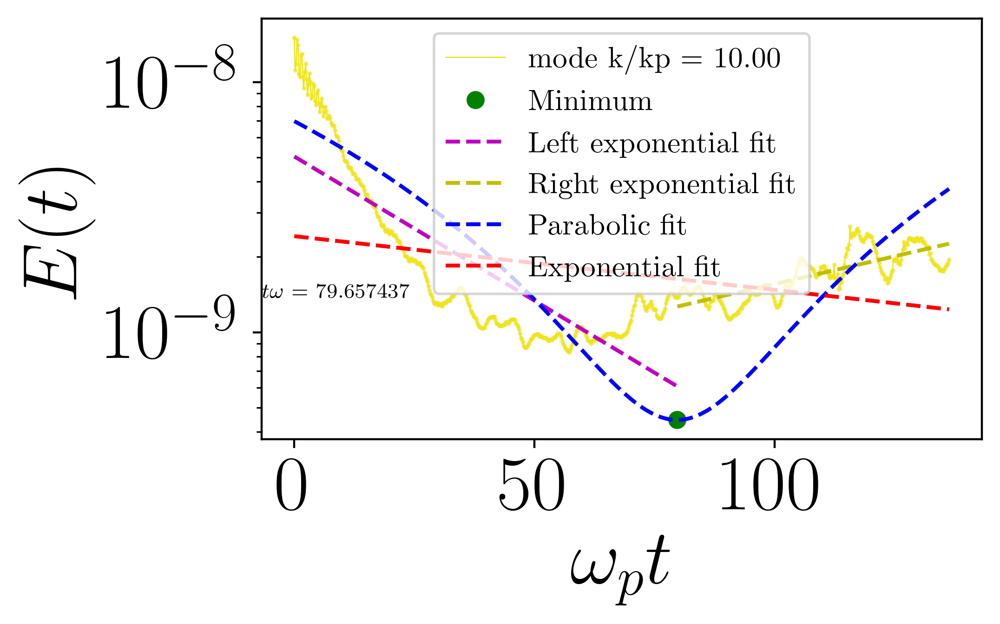

Parabolic fit: k/kp = 10.00,SSE = 1.09e-15, R^2 = 0.65051 time where behaviour changes $\omega t$ 79.65743679041137
RMSE of parabolic fit: 0.00000
a 2.4206003566122206e-09 b -0.004942517123885924
[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915, 0.008562762037070168, 0.00769912701742822, 0.008048966655894276, 0.008426129332261606, 0.007892390515807132, 0.00757028155852688, 0.00793577825963073, 0.009460819860207824, 0.01050744555679

<Figure size 6000x2400 with 0 Axes>

Exponential fit: k/kp = 10.00, slope = -0.00494, SSE = 2.81e-15, R^2 = 0.09669


In [20]:
beta_growth = []
beta_decay = []
k_growth = []
k_decay = []

tiempos_minimos = []
kp_minimos = []

sse_values =[]
r2_values =[]

slopes_exp =[]
slopes_exp_decay =[]

for idx, column in enumerate(df_pivot.columns[1:]):
    mode_total_norm = df_pivot[column].values
    # Start a new figure for each mode
    fig, ax = plt.subplots(figsize=[5, 3])
    color = cm.viridis(idx / len(df_pivot.columns[1:]))
    
    
    tiempo = omegap*(time-tstart)
    
    ax.plot(tiempo, mode_total_norm, '-', color=color, lw=0.5, label=f'mode k/kp = {idx/kp:.2f}')
    ax.scatter(tiempo, mode_total_norm, color=color, s=0.5, alpha=0.7)
    
    # Exponential fit
    p = np.polyfit(tiempo, np.log(mode_total_norm), 1)
    a = np.exp(p[1])
    b = p[0]
    y_exponential = a * np.exp(b * tiempo)
    
    slope = b
    
    concavity = "upwards" if b > 0 else "downwards"
    
    # Calculate SSR and R^2 for exponential fit
    residuals_exp = mode_total_norm - y_exponential
    ssr_exp = np.sum(residuals_exp ** 2)
    sst_exp = np.sum((mode_total_norm - np.mean(mode_total_norm)) ** 2)
    r2_exp = 1 - (ssr_exp / sst_exp)
    
    if r2_exp > 0.8:
    
        if b>0:
            print('1')
            beta_growth.append(b)
            k_growth.append(idx / kp)
            print(idx / kp)
        else:
            print('2')
            beta_decay.append(b)
            k_decay.append(idx / kp)
            print(idx / kp)
    
    # Append to lists
    sse_values.append(ssr_exp)
    r2_values.append(r2_exp)
    
    # Check if the R^2 value is below the threshold
    if r2_exp < 0.8:
        #print('entra')
        # Perform a parabolic fit
        #print('tiempo', tiempo)
        coefficients_parabola = np.polyfit(tiempo, mode_total_norm, 2)
        y_parabola = np.polyval(coefficients_parabola, tiempo)
        
        a_parabola, b_parabola, c_parabola = coefficients_parabola
        
        concavity = "upwards" if a > 0 else "downwards"
        
        if a != 0:  # a different of zero so we don't divide by zero
            x_minimo = - b_parabola / (2 * a_parabola) 
            print('x minimo',x_minimo)
            y_minimo = np.polyval(coefficients_parabola, x_minimo)
            if (x_minimo>tiempo[0]) & (x_minimo<tiempo[-1]):
                plt.plot(x_minimo, y_minimo, 'go', label='Minimum')
        else:
            x_minimo = None
            y_minimo = None

        concavity = "upwards" if a_parabola > 0 else "downwards"
        
        # verify is critical point is in the proper interval
        if x_minimo > tiempo[0] and x_minimo < tiempo[-1]:
            # Divide data around this critical point 
            left_mask = tiempo < x_minimo
            right_mask = tiempo > x_minimo
            
            if left_mask.any():
                p_left = np.polyfit(tiempo[left_mask], np.log(mode_total_norm[left_mask]), 1)
                a_left = np.exp(p_left[1])
                b_left = p_left[0]
                y_left_exp = a_left * np.exp(b_left * tiempo[left_mask])
                ax.plot(tiempo[left_mask], y_left_exp, 'm--', label='Left exponential fit')
                if b_left > 0:
                    beta_growth.append(b_left)
                    k_growth.append(idx / kp)
                else:
                    beta_decay.append(b_left)
                    k_decay.append(idx / kp)

            # Right segment
            if right_mask.any():
                p_right = np.polyfit(tiempo[right_mask], np.log(mode_total_norm[right_mask]), 1)
                a_right = np.exp(p_right[1])
                b_right = p_right[0]
                y_right_exp = a_right * np.exp(b_right * tiempo[right_mask])

                if b_right > 0:
                    beta_growth.append(b_right)
                    k_growth.append(idx/ kp)
                else:
                    beta_decay.append(b_right)
                    k_decay.append(idx / kp)

                
                ax.plot(tiempo[right_mask], y_right_exp, 'y--', label='Right exponential fit')
        else: # If not take exp fit 
            if b>0:
                print('7')
                beta_growth.append(b)
                k_growth.append(idx / kp)
                print(idx/ kp)
                    
            else:
                print('8')
                beta_decay.append(b)
                k_decay.append(idx/ kp)
                print(idx / kp)
           
        # Calculate residuals for the parabolic fit
        residuals_parabola = mode_total_norm - y_parabola
        rmse = np.sqrt(np.mean(residuals_parabola**2))
        
        ssr_parab= np.sum(residuals_parabola ** 2)
        sst_parab = np.sum((mode_total_norm - np.mean(mode_total_norm)) ** 2)
        r2_parab = 1 - (ssr_parab / sst_parab)
        
        # Plot the parabolic fit
        plt.plot(tiempo, y_parabola, 'b--', label='Parabolic fit')
        ax.plot(tiempo, y_exponential, 'r--', label='Exponential fit')
        plt.legend()
        #plt.xscale('log')
        plt.yscale('log')
        plt.xlabel('$\omega_{p} t$')
        plt.ylabel('$E(t)$')
        
        
        x0, xmax = plt.xlim()
        y0, ymax = plt.ylim()
        data_width = xmax - x0
        data_height = ymax - y0
        plt.text(x0 + 0.1, y0+0.000000001, f'$t \omega$ = {x_minimo:2f}')
        
        tiempos_minimos.append(x_minimo)
        kp_minimos.append(idx/kp)
        
        plt.show()
        # Print the results
        print(f'Parabolic fit: k/kp = {idx/kp:.2f},SSE = {ssr_parab:.2e}, R^2 = {r2_parab:.5f}', r'time where behaviour changes $\omega t$', x_minimo )
        print(f'RMSE of parabolic fit: {rmse:.5f}')
        print('a',a,'b',b)

        
    else:
        ax.plot(tiempo, y_exponential, 'r--', label='Exponential fit')
    
    print(beta_growth,beta_decay,k_growth,k_decay)
    
    ax.set_xlabel('$\omega_{p} t$')
    ax.set_ylabel('$E(t)$')
    ax.set_yscale('log')
    #ax.set_xscale('log')
    ax.legend(fontsize="7")
    ax.grid(True)
    plt.savefig(f'/projects/DEIKE/cmartinb/graphs/2D_spectra/kpHs{kpHs}uoc{uoc}/mode_kokp{idx/kp}.png')
    plt.show()
    
    print(f'Exponential fit: k/kp = {idx/kp:.2f}, slope = {slope:.5f}, SSE = {ssr_exp:.2e}, R^2 = {r2_exp:.5f}')

    if slope < 0:
        slopes_exp_decay.append(slope)
        k_decay.append(idx)
    
    slopes_exp.append(slope)

#### Here we save a file with times and k caracteristic: where behavior is only the first, not changing the behavior.


Tiempo característico: -0.21883323179560896


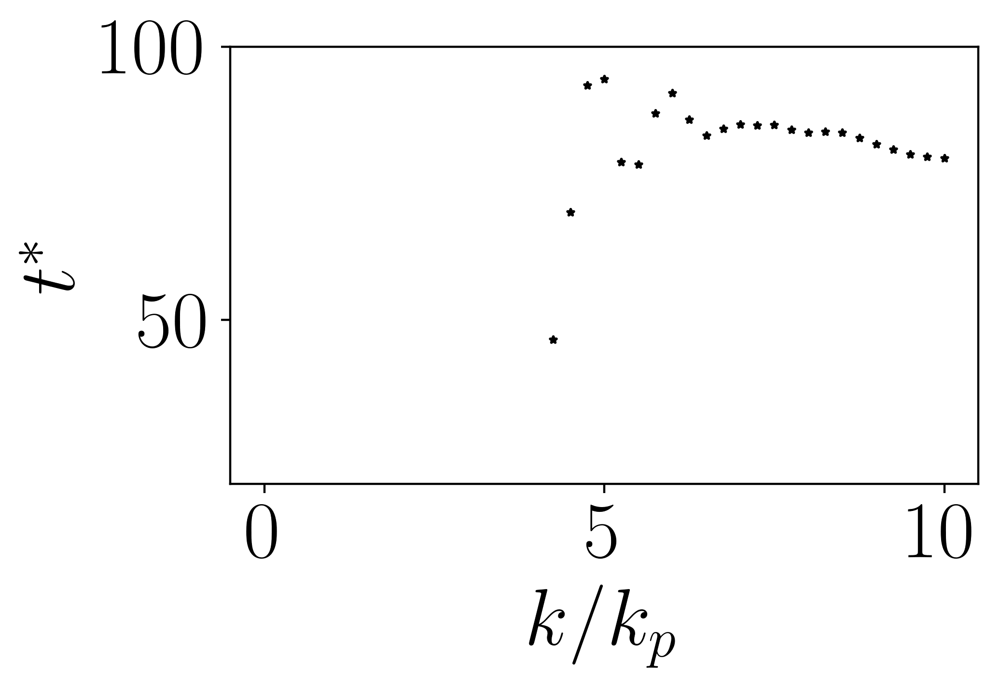

In [21]:
fig = plt.figure(figsize=[5, 3])
plt.scatter(kp_minimos,tiempos_minimos, s =6, marker ="*", color='black')
#plt.axhline(y = 80, color = 'r', linestyle = '--', lw = 0.3) 
#plt.axhline(y = 0, color = 'r', linestyle = '--', lw = 0.3) 
plt.ylabel(r'$t^{*}$')
plt.xlabel(r'$k/k_{p}$')
plt.ylim([20,100])
#plt.xlim([5.4,10])


# Crear un DataFrame con los datos
df_datos = pd.DataFrame({
    'kp_minimos': kp_minimos,
    'tiempos_minimos': tiempos_minimos
})

# Guardar en CSV
df_datos.to_csv(f'/projects/DEIKE/cmartinb/datos/datos_re{reA}_bo0{Bo}_P{kpHs}_uoc{uoc}_reW{reW}_L{maxLevel}.csv.csv', index=False)

tiempo_caracteristico = np.mean(tiempos_minimos)
print(f'Tiempo característico: {tiempo_caracteristico}')

#### Do the fit below the caracteristic time

In [22]:
tiempo_caracteristico = 66

In [23]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# Definir la función del modelo exponencial
def exp_model(x, a, b):
    return a * np.exp(b * x)

# Inicializar listas para almacenar los resultados
beta_growth_below_40, beta_decay_below_40 = [], []
beta_growth_above_40, beta_decay_above_40 = [], []
k_growth_below_40, k_decay_below_40 = [], []
k_growth_above_40, k_decay_above_40 = [], []

# Definir el tiempo característico (ajusta según tus datos)
#tiempo_caracteristico = 40

# Identificar los índices de tiempo por debajo y por encima de 40
below_40 = tiempo < tiempo_caracteristico
above_40 = tiempo >= tiempo_caracteristico

# Suponiendo que 'k_seleccionados' es una lista de índices seleccionados y que 'df_pivot' tiene las columnas correspondientes
for i in range(len(df_pivot.columns[1:])):
    column = df_pivot.columns[i + 1]  # Ajustar el índice para omitir la primera columna
    mode_total_norm = np.array(df_pivot[column].values)

    # Ajuste para tiempos por debajo de 40
    if below_40.any():
        try:
            p_full_below_40, _ = curve_fit(exp_model, tiempo[below_40], mode_total_norm[below_40], p0=(1, 0.001))
            b_full_below_40 = p_full_below_40[1]
            # Clasificar según el signo de b_full_below_40
            if b_full_below_40 > 0:
                beta_growth_below_40.append(b_full_below_40)
                k_growth_below_40.append(k_seleccionados[i])
            else:
                beta_decay_below_40.append(b_full_below_40)
                k_decay_below_40.append(k_seleccionados[i])
        except RuntimeError:
            print(f"Error al ajustar el modo {i} por debajo de 40.")

    # Ajuste para tiempos por encima de 40
    if above_40.any():
        try:
            p_full_above_40, _ = curve_fit(exp_model, tiempo[above_40], mode_total_norm[above_40], p0=(1, 0.001))
            b_full_above_40 = p_full_above_40[1]
            # Clasificar según el signo de b_full_above_40
            if b_full_above_40 > 0:
                beta_growth_above_40.append(b_full_above_40)
                k_growth_above_40.append(k_seleccionados[i])
            else:
                beta_decay_above_40.append(b_full_above_40)
                k_decay_above_40.append(k_seleccionados[i])
        except RuntimeError:
            print(f"Error al ajustar el modo {i} por encima de 40.")

# Imprimir resultados (asegúrate de definir e inicializar correctamente todas las listas involucradas)
print("Growth betas below 40:", beta_growth_below_40, len(beta_growth_below_40))
print("Decay betas below 40:", beta_decay_below_40, len(beta_decay_below_40))
print("Growth ks below 40:", k_growth_below_40, len(k_growth_below_40))
print("Decay ks below 40:", k_decay_below_40, len(k_decay_below_40))

print("Growth betas above 40:", beta_growth_above_40, len(beta_growth_above_40))
print("Decay betas above 40:", beta_decay_above_40, len(beta_decay_above_40))
print("Growth ks above 40:", k_growth_above_40, len(k_growth_above_40))
print("Decay ks above 40:", k_decay_above_40, len(k_decay_above_40))


Growth betas below 40: [0.005127484254625656, 0.005665069356868728, 0.006127314329587788, 0.006531222732776497, 0.007100159815426882, 0.007689322606822245, 0.00800672372317256, 0.007794227031229716, 0.006845280347029978, 0.0069818850715048075, 0.007839948933146879, 0.006152088502480923, 0.004010122207498127, 0.0042006471655318955, 0.005152027811579996, 0.00405915170255578, 0.00043377954877799816] 17
Decay betas below 40: [-0.0026073296044718153, -0.004977139887158484, -0.00595663225072924, -0.006363446908888203, -0.010312690093259913, -0.013690315803544005, -0.015106271509435224, -0.017398160740212283, -0.020275896609234862, -0.02336434316871639, -0.02563508802737908, -0.028146799711738706, -0.03117037719181591, -0.03370555665153861, -0.038339370361255926, -0.04251394334839541, -0.04357439971938645, -0.0451573365719803, -0.04949805691175345, -0.056047500790010675, -0.06129463455748272, -0.06537440566568617, -0.07016869567914508, -0.07495467534946765] 24
Growth ks below 40: [0.0, 1.0, 2

[0.004144406259074905, 0.005331804700260806, 0.006395066066779681, 0.006904408459451279, 0.007469311544336729, 0.008335206220669376, 0.008775121666530382, 0.008648402251566763, 0.00855480015924047, 0.008574624139727989, 0.00851713066422593, 0.0068515245625654815, 0.005614751087795264, 0.006115576262573329, 0.004910276160779954, 0.0035730498589610807, 0.003213255364883775, 0.005197991094494537, 0.004330055504719101, 0.0023900324539476324, 0.00506068062910096, 0.007541097781025406, 0.002798925347933615, 0.00335680674186261, 0.006056742630560502, 0.00842160341596459, 0.010062022090638268, 0.009385542764820915, 0.008562762037070168, 0.00769912701742822, 0.008048966655894276, 0.008426129332261606, 0.007892390515807132, 0.00757028155852688, 0.00793577825963073, 0.009460819860207824, 0.010507445556790196, 0.01009875549958167, 0.010220072079663516] [-0.0029886704447841883, -0.004951534257230859, -0.0038583839284774693, -0.000290200782340919, -0.003894740101207483, -0.0009013836355904934, -0.00

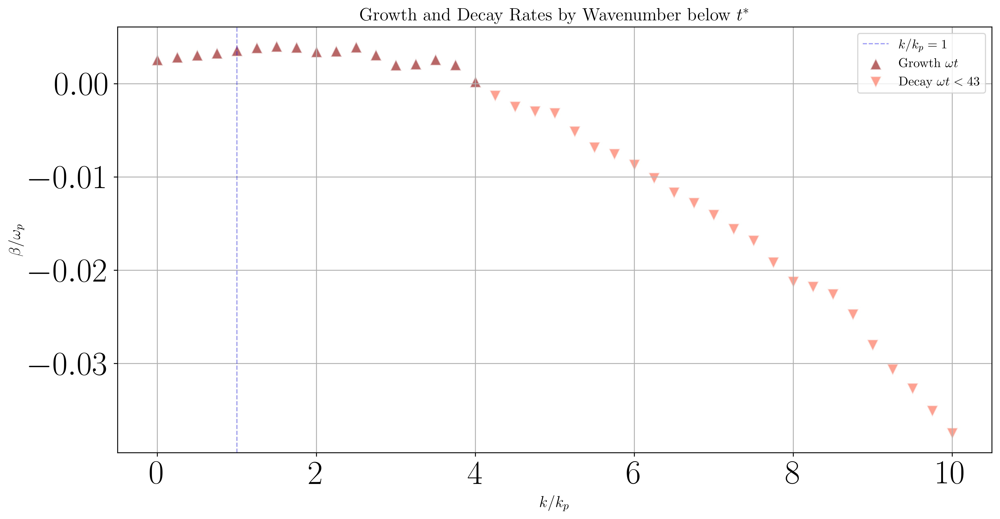

In [24]:
import matplotlib.pyplot as plt

# Tamaño del gráfico
fig, ax = plt.subplots(figsize=(14, 7))

print(beta_growth, beta_decay)
# Gráfico de dispersión para el crecimient
plt.scatter([k/4 for k in k_growth_below_40], [beta/omegap for beta in beta_growth_below_40], c='darkred', marker= "^", label=r'Growth $\omega t$', alpha=0.6, edgecolors='w', s=100)
plt.scatter([(k)/4  for k in k_decay_below_40], [beta/omegap for beta in beta_decay_below_40] , c='tomato', marker = "v", label=r'Decay $\omega t <43$ ', alpha=0.6, edgecolors='w', s=100)
#plt.scatter([k/4 for k in k_growth_below_40_discrete], [beta/omegap for beta in beta_growth_below_40_discrete] , c='navy', marker= "^",label=r'Growth $\omega t < 44 $ discrete', alpha=0.6, edgecolors='w', s=100)
#plt.scatter([k/4  for k in k_decay_below_40_discrete], [beta/omegap for beta in beta_decay_below_40_discrete], c='cornflowerblue', marker = "v", label=r'Decay $\omega t < 44$ discrete ', alpha=0.6, edgecolors='w', s=100)

#plt.plot(np.array(k_seleccionados[:-num]/4),np.array(slopes_exp), 'o', alpha =0.5, c='grey')
# Gráfico de dispersión para el decaimiento

# Añadir etiquetas y título
plt.xlabel('$k/k_p$', fontsize=14)
plt.ylabel('$\\beta / \omega_{p}$', fontsize=14)
plt.title(r'Growth and Decay Rates by Wavenumber below $t^{\ast}$', fontsize=16)
plt.axvline(x=1, color='blue', linestyle='--', linewidth=1, alpha= 0.4,  label=r'$k/k_{p}=1$')
# Añadir leyenda
plt.legend()

# Añadir cuadrícula para mejor visualización
plt.grid(True)

# Ajustar límites si es necesario
#plt.xlim([-0.4, 10])
#plt.ylim([-0.0025, 0.0025])
#plt.ylim([-0.007, 0.0035])
# Mostrar el gráfico
plt.show()

In [25]:
# Creación de DataFrames para growth y decay por debajo de 40
df_growth_below_40 = pd.DataFrame({
    'Tipo': 'Growth',
    'Beta': beta_growth_below_40,
    'k': k_growth_below_40
})

df_decay_below_40 = pd.DataFrame({
    'Tipo': 'Decay',
    'Beta': beta_decay_below_40,
    'k': k_decay_below_40
})

df_beta_below_40 = pd.concat([df_growth_below_40, df_decay_below_40], axis=0).reset_index(drop=True)

# Guardar el DataFrame combinado en un archivo CSV para los valores por debajo de 40
df_beta_below_40.to_csv(f'/projects/DEIKE/cmartinb/betas/betas_re{reA}_bo0{Bo}_P{kpHs}_uoc{uoc}_reW{reW}_L{maxLevel}_below_{tiempo_caracteristico}.csv', index=False)


In [26]:
print(f'/projects/DEIKE/cmartinb/betas/betas_re{reA}_bo0{Bo}_P{kpHs}_uoc{uoc}_reW{reW}_L{maxLevel}_below_{tiempo_caracteristico}.csv')

/projects/DEIKE/cmartinb/betas/betas_re720_bo0200_P0p08_uoc0p50_reW2.5e4_L10_below_66.csv
